In [1]:
from glob import glob

import matplotlib as mpl
import matplotlib.pyplot as plt
import numpy as np
import pandas as pd
import seaborn as sns
from scipy import stats
import anndata
mpl.style.use("default")
mpl.rcParams["pdf.fonttype"] = 42
mpl.rcParams["ps.fonttype"] = 42
mpl.rcParams["font.family"] = "sans-serif"
mpl.rcParams["font.sans-serif"] = "Helvetica"
from ALLCools.plot import *
from gliderport.preset import notebook_snakemake

In [2]:
region_to_subregion = {'CTX': ['MOp','SSp','ACA','AI','RSP','AUD','PTLp','VIS'],
                       'HIP': ['CAa','CAp','DGa','DGp'],
                       'RHP': ['ENT'],
                       'OLF': ['MOB', 'AON'],
                       'PIR': ['PIRa','PIRp'],
                       'STR': ['STR'],
                       'PAL': ['PAL'],
                       'AMY': ['AMY'],
                       'TH': ['THm','THl','THp'],
                       'HY': ['HY'],
                       'MB': ['SC','MRN','VTA','PAG','IC'],
                       'HB': ['P','MY']
                      }

In [3]:
rs1_subregion_dict = {
    "MOp": ["MOp-2", "MOp-3"],
    "SSp": ["SSp-3", "SSp-4"],
    "ACA": ["PFC-2", "ACA-1", "ACA-2"],
    "AI": ["AI"],
    "RSP": ["RSP-3", "RSP-4"],
    "AUD": ["AUD-1", "AUD-2"],
    "PTLp": ["PTLp"],
    "VIS": ["VIS-2", "VIS-3"],
    "ENT": ["RHP-1", "RHP-2", "RHP-3", "RHP-5"],
    "CAa": ["CA-i", "CA-ii"],
    "CAp": ["CA-iii", "CA-iv"],
    "DGa": ["DG-1", "DG-2"],
    "DGp": ["DG-3", "DG-4"],
    "MOB": ["MOB"],
    "AON": ["AON"],
    "PIRa": ["PIR-1", "PIR-2", "PIR-3", "PIR-4"],
    "PIRp": ["PIR-5", "PIR-6", "PIR-7", "PIR-8"],
    "AMY": ["AMY-1", "AMY-2", "AMY-3"],
    "STR": ["CP-1", "CP-2", "CP-3"],
    "PAL": ["PAL-1", "PAL-2", "PAL-3", "GP"],
    "THm": ["TH-2", "TH-4"],
    "THl": ["TH-1", "TH-3"],
    "THp": ["TH-5", "TH-6", "TH-7"],
    "HY": ["HY-1", "HY-2", "HY-3", "HY-4"],
    "SC": ["SC-1", "SC-2", "SC-3"],
    "MRN": ["PAG-3", "PAG-4", "MRN"],
    "VTA": ["VTA-1", "VTA-2"],
    "PAG": ["PAG-1", "PAG-2"],
    "IC": ["IC-1"],
    "P": ["PRN-1", "PRN-2", "PRN-3", "PRN-4", "PCG"],
    "MY": ["MY-1", "MY-2", "MY-3", "MY-4"],
    "CBX": ["CB-1", "CB-2", "CB-5"],
}
rs2_subregion_dict = {
    'MOp': ['3C', '4B'],
    'SSp': ['6B', '7B'],
    'ACA': ['3A', '4A', '5A'],
    'AI': ['3D'],
    'AUD': ['9D', '10C'],
    'RSP': ['9A', '10A'],
    'PTLp': ['9B'],
    'VIS': ['11B', '12B'],
    'ENT': ['10D11D12D13B'],
    'CAa': ['8E9H'],
    'CAp': ['10E11E'],
    'DGa': ['8J9J'],
    'DGp': ['10F11F'],
    'MOB': ['1C'],
    'AON': ['2E'],
    'PIRa': ['2D3E4F5G'],
    'PIRp': ['6D7D8D9E'],
    'AMY': ['7H8H9G'],
    'STR': ['4D5E6E'],
    'PAL': ['4H5H6F7F', '6F7F'],
    'THm': ['7G8G'], 
    'THl': ['7E8F'], 
    'THp': ['9K10G'],
    'HY': ['6H7J8K9L'],
    'SC': ['11G12F13C'],
    'MRN': ['10H11H12H'],
    'VTA': ['10J11J'],
    'PAG': ['12G13D'],
    'IC': ['14A'],
    'P': ['12J13E13F14C14D'],
    'MY': ['15C16C17B18B'],
    'CBX': ['14B15B18A']
}


In [4]:
tarall = ['PFC', 'MOp', 'SSp', 'ACA', 'AI', 'AUDp', 'RSP', 'PTLp', 'VISp', 
          'ENT', 'HPF', 'MOB', 'PIR', 'AMY', 'STR', 'PAL', 
          'TH', 'HY', 'SC', 'VTA', 'P', 'MY', 
          'CBN', 'CBX']
print(len(tarall))

24


In [5]:
tartype = {
    "IT": [
        "PFC",
        "MOp",
        "SSp",
        "ACA",
        "AI",
        "AUDp",
        "RSP",
        "PTLp",
        "VISp",
        "MOB",
        "ENT",
        "HPF",
        "PIR",
        "AMY",
        "STR",
        "PAL",
    ],
    "ET": ["TH", "HY", "SC", "VTA", "P", "MY"],
    "CB": ["CBN", "CBX"],
}
tarmap = {yy: xx for xx in tartype for yy in tartype[xx]}

In [5]:
adata = anndata.read_h5ad('/cemba/CEMBA_RS2/cell_349658_RS1RS2_mCHmCG.h5ad')
adata

AnnData object with n_obs × n_vars = 349658 × 1
    obs: 'mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads', 'DissectionRegion', 'Plate', 'Col384', 'Row384', 'Slice', 'Sample', 'Technology', 'InputReads', 'PassBasicQC', 'PlateNormCov', 'CEMBARegion', 'MajorRegion', 'SubRegion', 'Study', 'Exp', 'Source', 'Target', 'Gender', 'L1', 'L2', 'L3', 'L4', 'L1_annot', 'L4_annot', 'tsne_0', 'tsne_1', 'L4_annot_AIBS', 'L1_annot_AIBS', 'L1_annot_LHQ', 'L4_annot_AIBS_NEW', 'L1_annot_AIBS_NEW', 'PlateNormReads'
    obsm: '100kCG_pca', '100kCH100kCG_pc66pc64_tsne', '100kCH_pca', 'X_pca', 'X_tsne'

In [49]:
meta_rs2 = pd.read_csv("/cemba/CEMBA_RS2/cell_48032_RS2_meta_nooutlier.csv.gz", index_col=0, header=0)
meta_rs2

,mCCCFrac,mCGFrac,mCHFrac,FinalmCReads,Plate,PlateNormReads,Exp,Source,DissectionRegion,Target,Sex,L1,L2,L3,L4,L1_annot,PassTargetFilter
cell,,,,,,,,,,,,,,,,,
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD001,0.006500,0.775850,0.032027,1090870.0,180117_P1,-0.555116,Tm3C,MOp,3C,SC,male,c14,c14_c6,c14_c6_c0,c14_c6_c0_c0,ET,True
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD002,0.006709,0.775146,0.034091,1458065.0,180117_P1,-0.136540,Tf3C,MOp,3C,SC,female,c14,c14_c5,c14_c5_c0,c14_c5_c0_c0,ET,True
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD004,0.007131,0.775895,0.035900,1614993.0,180117_P1,0.010933,Tm4B,MOp,4B,SC,male,c14,c14_c6,c14_c6_c1,c14_c6_c1_c0,ET,True
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD006,0.006032,0.773345,0.028591,1598778.0,180117_P1,-0.003626,Tf4B,MOp,4B,SC,female,c14,c14_c0,c14_c0_c0,c14_c0_c0_c1,ET,True
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD007,0.005007,0.773471,0.022022,762007.0,180117_P2,-1.169393,Pm3C,MOp,3C,STR,male,c1,c1_c1,c1_c1_c3,c1_c1_c3_c2,IT-Sup,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Pool180_Plate9-6-M14-O24,0.004759,0.737593,0.018632,1237195.0,Pool180_Plate9,0.305202,Zf10D11D12D13B,ENT,10D11D12D13B,PFC,female,c4,c4_c3,c4_c3_c1,c4_c3_c1_c2,OLF,True
Pool180_Plate9-6-M14-P11,0.005464,0.759072,0.024842,1103912.0,Pool180_Plate9,0.140754,Zm10D11D12D13B,ENT,10D11D12D13B,PFC,male,c4,c4_c4,c4_c4_c2,c4_c4_c2_c0,OLF,True
Pool180_Plate9-6-M14-P12,0.006196,0.792529,0.029565,818886.0,Pool180_Plate9,-0.290136,Zm10D11D12D13B,ENT,10D11D12D13B,PFC,male,c4,c4_c6,c4_c6_c1,c4_c6_c1_c0,OLF,True


In [7]:
adata_neu = adata[~adata.obs['L1_annot'].isin(['ASC','ODC','OPC','MGC'])].copy()
adata_neu


AnnData object with n_obs × n_vars = 312125 × 1
    obs: 'mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads', 'DissectionRegion', 'Plate', 'Col384', 'Row384', 'Slice', 'Sample', 'Technology', 'InputReads', 'PassBasicQC', 'PlateNormCov', 'CEMBARegion', 'MajorRegion', 'SubRegion', 'Study', 'Exp', 'Source', 'Target', 'Gender', 'L1', 'L2', 'L3', 'L4', 'L1_annot', 'L4_annot', 'tsne_0', 'tsne_1', 'L4_annot_AIBS', 'L1_annot_AIBS', 'L1_annot_LHQ', 'L4_annot_AIBS_NEW', 'L1_annot_AIBS_NEW', 'PlateNormReads'
    obsm: '100kCG_pca', '100kCH100kCG_pc66pc64_tsne', '100kCH_pca', 'X_pca', 'X_tsne'

In [8]:
npc_ch, npc_cg = 66, 64
tmp1 = adata_neu.obsm['100kCH_pca'][:, :npc_ch]
tmp1 = tmp1 / np.std(tmp1)
tmp2 = adata_neu.obsm['100kCG_pca'][:, :npc_cg]
tmp2 = tmp2 / np.std(tmp2)
adata_neu.obsm['X_pca'] = np.concatenate([tmp1, tmp2], axis=1)


In [9]:
from ALLCools.clustering import tsne

def dump_embedding(adata, name, n_dim=2):
    # put manifold coordinates into adata.obs
    for i in range(n_dim):
        adata.obs[f'{name}_{i}'] = adata.obsm[f'X_{name}'][:, i]
    return adata

tsne(adata_neu, obsm='X_pca', metric='euclidean', exaggeration=-1, perplexity=50, n_jobs=-1)
dump_embedding(adata_neu, 'tsne')
adata_neu.obsm[f'100kCH100kCG_pc{npc_ch}pc{npc_cg}_tsne'] = adata_neu.obsm['X_tsne'].copy()



In [7]:
meta_rs2 = meta_rs2[meta_rs2['PassTargetFilter']]
meta_rs2

,mCCCFrac,mCGFrac,mCHFrac,FinalmCReads,Plate,PlateNormReads,Exp,Source,DissectionRegion,Target,Sex,L1,L2,L3,L4,L1_annot,PassTargetFilter
cell,,,,,,,,,,,,,,,,,
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD001,0.006500,0.775850,0.032027,1090870.0,180117_P1,-0.555116,Tm3C,MOp,3C,SC,male,c14,c14_c6,c14_c6_c0,c14_c6_c0_c0,ET,True
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD002,0.006709,0.775146,0.034091,1458065.0,180117_P1,-0.136540,Tf3C,MOp,3C,SC,female,c14,c14_c5,c14_c5_c0,c14_c5_c0_c0,ET,True
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD004,0.007131,0.775895,0.035900,1614993.0,180117_P1,0.010933,Tm4B,MOp,4B,SC,male,c14,c14_c6,c14_c6_c1,c14_c6_c1_c0,ET,True
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD006,0.006032,0.773345,0.028591,1598778.0,180117_P1,-0.003626,Tf4B,MOp,4B,SC,female,c14,c14_c0,c14_c0_c0,c14_c0_c0_c1,ET,True
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD007,0.005007,0.773471,0.022022,762007.0,180117_P2,-1.169393,Pm3C,MOp,3C,STR,male,c1,c1_c1,c1_c1_c3,c1_c1_c3_c2,IT-Sup,True
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Pool180_Plate9-6-M14-O24,0.004759,0.737593,0.018632,1237195.0,Pool180_Plate9,0.305202,Zf10D11D12D13B,ENT,10D11D12D13B,PFC,female,c4,c4_c3,c4_c3_c1,c4_c3_c1_c2,OLF,True
Pool180_Plate9-6-M14-P11,0.005464,0.759072,0.024842,1103912.0,Pool180_Plate9,0.140754,Zm10D11D12D13B,ENT,10D11D12D13B,PFC,male,c4,c4_c4,c4_c4_c2,c4_c4_c2_c0,OLF,True
Pool180_Plate9-6-M14-P12,0.006196,0.792529,0.029565,818886.0,Pool180_Plate9,-0.290136,Zm10D11D12D13B,ENT,10D11D12D13B,PFC,male,c4,c4_c6,c4_c6_c1,c4_c6_c1_c0,OLF,True


In [11]:
meta_rs2[['Target','Source']].value_counts().shape

(225,)

In [30]:
adata_neu.obs[['MajorRegion', 'SubRegion', 'DissectionRegion']] = adata_neu.obs[['MajorRegion', 'SubRegion', 'DissectionRegion']].astype(str)
rs2filter = (adata_neu.obs['Study']=='CEMBA_EpiRetro')
adata_neu.obs.loc[rs2filter, 'DissectionRegion'] = adata_neu.obs.loc[rs2filter, 'Slice'].values
d2s = {yy:xx for xx in rs2_subregion_dict for yy in rs2_subregion_dict[xx]}
s2m = {yy:xx for xx in region_to_subregion for yy in region_to_subregion[xx]}
adata_neu.obs.loc[rs2filter, 'SubRegion'] = adata_neu.obs.loc[rs2filter, 'DissectionRegion'].map(d2s).values
adata_neu.obs.loc[rs2filter, 'MajorRegion'] = adata_neu.obs.loc[rs2filter, 'SubRegion'].map(s2m).values


In [13]:
meta_rs2['TargetGroup'] = meta_rs2['Target'].map(tarmap)
meta_rs2['TargetGroup'].value_counts()


IT    19256
ET    12858
CB      920
Name: TargetGroup, dtype: int64

In [14]:
adata_neu.obs['TargetGroup'] = '?'
adata_neu.obs.loc[meta_rs2.index, 'TargetGroup'] = meta_rs2['TargetGroup'].values


In [8]:
adata_neu = anndata.read_h5ad('cell_312125_Neu_RS1RS2_mCHmCG.h5ad')
adata_neu

AnnData object with n_obs × n_vars = 312125 × 1
    obs: 'mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads', 'DissectionRegion', 'Plate', 'Col384', 'Row384', 'Slice', 'Sample', 'Technology', 'InputReads', 'PassBasicQC', 'PlateNormCov', 'CEMBARegion', 'MajorRegion', 'SubRegion', 'Study', 'Exp', 'Source', 'Target', 'Gender', 'L1', 'L2', 'L3', 'L4', 'L1_annot', 'L4_annot', 'tsne_0', 'tsne_1', 'L4_annot_AIBS', 'L1_annot_AIBS', 'L1_annot_LHQ', 'L4_annot_AIBS_NEW', 'L1_annot_AIBS_NEW', 'PlateNormReads', 'TargetGroup'
    obsm: '100kCG_pca', '100kCH100kCG_pc66pc64_tsne', '100kCH_pca', 'X_pca', 'X_tsne'

In [7]:
adata_neu.obs['Study'].value_counts()

CEMBA_snmC        276187
CEMBA_EpiRetro     35938
Name: Study, dtype: int64

In [10]:
adata_neu.obs['TargetGroup'] = adata_neu.obs['TargetGroup'].astype(str)


In [11]:
reg_list = []
for xx in region_to_subregion:
    count = adata_neu.obs.loc[(adata_neu.obs['TargetGroup'].isin(['IT', 'ET'])) & (adata_neu.obs['MajorRegion']==xx), 'TargetGroup'].value_counts()
    if count.shape[0]==2:
        reg_list.append(xx)
    print(xx)
    print(count)
    

CTX
IT    10411
ET     6133
Name: TargetGroup, dtype: int64
HIP
IT    752
ET     86
Name: TargetGroup, dtype: int64
RHP
IT    1397
ET     112
Name: TargetGroup, dtype: int64
OLF
IT    220
ET    104
Name: TargetGroup, dtype: int64
PIR
IT    861
ET    104
Name: TargetGroup, dtype: int64
STR
ET    194
Name: TargetGroup, dtype: int64
PAL
ET    552
IT    129
Name: TargetGroup, dtype: int64
AMY
IT    999
ET    426
Name: TargetGroup, dtype: int64
TH
IT    1963
ET     410
Name: TargetGroup, dtype: int64
HY
ET    961
IT    577
Name: TargetGroup, dtype: int64
MB
ET    2054
IT    1721
Name: TargetGroup, dtype: int64
HB
ET    1667
Name: TargetGroup, dtype: int64


In [7]:
from itertools import cycle, islice
from wmb import brain
colors = pd.read_csv('/cemba/CEMBA_RS2/source_palette.tsv', header=0, index_col=0, sep='\t')
colors = colors[['SubRegion', 'SubRegionColor']].drop_duplicates().set_index('SubRegion')['SubRegionColor'].to_dict()
# color = np.array(list(islice(cycle(['#e6194b','#3cb44b','#ffe119','#0082c8','#f58231',
#                                     '#911eb4','#46f0f0','#f032e6','#d2f53c','#fabebe',
#                                     '#008080','#e6beff','#aa6e28','#800000','#aaffc3',
#                                     '#808000','#ffd8b1','#000080','#808080','#000000']), 100)))

# tarcolor = pd.read_csv('/gale/netapp/home/zhoujt/project/CEMBA/RS2/target_id.txt', header=1, index_col=None, sep='\t')
# tarcolor = tarcolor.loc[:,tarcolor.columns.isin(adata.obs['Target'])]
# tarcolor = {xx:yy for xx,yy in zip(tarcolor.keys(), color[::-1])}
tarcolor = {xx:yy for xx,yy in zip(tarall, sns.color_palette('hls', len(tarall)))}
tarcolor


{'PFC': (0.86, 0.3712, 0.33999999999999997),
 'MOp': (0.86, 0.5012, 0.33999999999999997),
 'SSp': (0.86, 0.6312, 0.33999999999999997),
 'ACA': (0.86, 0.7612000000000001, 0.33999999999999997),
 'AI': (0.8287999999999999, 0.86, 0.33999999999999997),
 'AUDp': (0.6988, 0.86, 0.33999999999999997),
 'RSP': (0.5688000000000001, 0.86, 0.33999999999999997),
 'PTLp': (0.43879999999999986, 0.86, 0.33999999999999997),
 'VISp': (0.33999999999999997, 0.86, 0.3712),
 'ENT': (0.33999999999999997, 0.86, 0.5012000000000001),
 'HPF': (0.33999999999999997, 0.86, 0.6312),
 'MOB': (0.33999999999999997, 0.86, 0.7612000000000001),
 'PIR': (0.33999999999999997, 0.8287999999999999, 0.86),
 'AMY': (0.33999999999999997, 0.6988, 0.86),
 'STR': (0.33999999999999997, 0.5688000000000001, 0.86),
 'PAL': (0.33999999999999997, 0.43879999999999986, 0.86),
 'TH': (0.3712, 0.33999999999999997, 0.86),
 'HY': (0.5011999999999995, 0.33999999999999997, 0.86),
 'SC': (0.6311999999999998, 0.33999999999999997, 0.86),
 'VTA': (0.7

In [9]:
ds = 0.5
coord_base = 'tsne'


In [16]:
import wmb
from wmb import cemba, mm10
palette = wmb.files.palette.PALETTES['AIBS.TENX.Annot.V2']

In [50]:
L4_to_L2annot = cemba.get_mc_annot()[['L4', 'L4Region_annot']].to_pandas().astype(str).value_counts().unstack(fill_value=0).idxmax(axis=1)
L4_to_L2annot

L4
c0_c0_c0_c0     MY Lhx1 Gly-Gaba
c0_c0_c0_c1     MY Lhx1 Gly-Gaba
c0_c0_c0_c2     MY Lhx1 Gly-Gaba
c0_c0_c0_c3     MY Lhx1 Gly-Gaba
c0_c0_c10_c0     MB/HB Lhx1 Glut
                      ...       
c9_c1_c1_c0              DG Glut
c9_c1_c1_c1              DG Glut
c9_c1_c2_c0              DG Glut
c9_c1_c2_c1              DG Glut
c9_c1_c2_c2              DG Glut
Length: 2573, dtype: object

In [52]:
meta_rs2['L2_annot'] = meta_rs2['L4'].map(L4_to_L2annot)

In [54]:
meta_rs2 = meta_rs2[['mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads', 'Plate', 'PlateNormReads', 'Exp', 'Source', 'DissectionRegion', 'Target', 'Sex', 'L1', 'L2', 'L3', 'L4', 'L1_annot', 'L2_annot', 'PassTargetFilter']]



Index(['mCCCFrac', 'mCGFrac', 'mCHFrac', 'FinalmCReads', 'Plate',
       'PlateNormReads', 'Exp', 'Source', 'DissectionRegion', 'Target', 'Sex',
       'L1', 'L2', 'L3', 'L4', 'L1_annot', 'PassTargetFilter', 'L2_annot'],
      dtype='object')

In [53]:
meta_rs2

,mCCCFrac,mCGFrac,mCHFrac,FinalmCReads,Plate,PlateNormReads,Exp,Source,DissectionRegion,Target,Sex,L1,L2,L3,L4,L1_annot,PassTargetFilter,L2_annot
cell,,,,,,,,,,,,,,,,,,
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD001,0.006500,0.775850,0.032027,1090870.0,180117_P1,-0.555116,Tm3C,MOp,3C,SC,male,c14,c14_c6,c14_c6_c0,c14_c6_c0_c0,ET,True,L5 ET CTX Glut
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD002,0.006709,0.775146,0.034091,1458065.0,180117_P1,-0.136540,Tf3C,MOp,3C,SC,female,c14,c14_c5,c14_c5_c0,c14_c5_c0_c0,ET,True,L5 ET CTX Glut
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD004,0.007131,0.775895,0.035900,1614993.0,180117_P1,0.010933,Tm4B,MOp,4B,SC,male,c14,c14_c6,c14_c6_c1,c14_c6_c1_c0,ET,True,L5 ET CTX Glut
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD006,0.006032,0.773345,0.028591,1598778.0,180117_P1,-0.003626,Tf4B,MOp,4B,SC,female,c14,c14_c0,c14_c0_c0,c14_c0_c0_c1,ET,True,L5 ET CTX Glut
180118_CEMBA_mm_P56_P63_RS2_180117_P1_180117_P2_A10_AD007,0.005007,0.773471,0.022022,762007.0,180117_P2,-1.169393,Pm3C,MOp,3C,STR,male,c1,c1_c1,c1_c1_c3,c1_c1_c3_c2,IT-Sup,True,L4/5 IT CTX Glut
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
Pool180_Plate9-6-M14-O24,0.004759,0.737593,0.018632,1237195.0,Pool180_Plate9,0.305202,Zf10D11D12D13B,ENT,10D11D12D13B,PFC,female,c4,c4_c3,c4_c3_c1,c4_c3_c1_c2,OLF,True,L2/3 IT ENT Glut
Pool180_Plate9-6-M14-P11,0.005464,0.759072,0.024842,1103912.0,Pool180_Plate9,0.140754,Zm10D11D12D13B,ENT,10D11D12D13B,PFC,male,c4,c4_c4,c4_c4_c2,c4_c4_c2_c0,OLF,True,L2/3 IT ENTl-PIR Glut
Pool180_Plate9-6-M14-P12,0.006196,0.792529,0.029565,818886.0,Pool180_Plate9,-0.290136,Zm10D11D12D13B,ENT,10D11D12D13B,PFC,male,c4,c4_c6,c4_c6_c1,c4_c6_c1_c0,OLF,True,LA-BLA-BMA-PA Glut


In [15]:
adata_neu.obs['L2_annot'] = adata_neu.obs['L4'].map(L4_to_L2annot)
adata_neu.obs['L2_annot'].isna().sum()

0

findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Helvetica
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Helvetica
findfont: Font family ['sans-serif'] not found. Falling back to DejaVu Sans.
findfont: Generic family 'sans-serif' not found because none of the following families were found: Helvetica


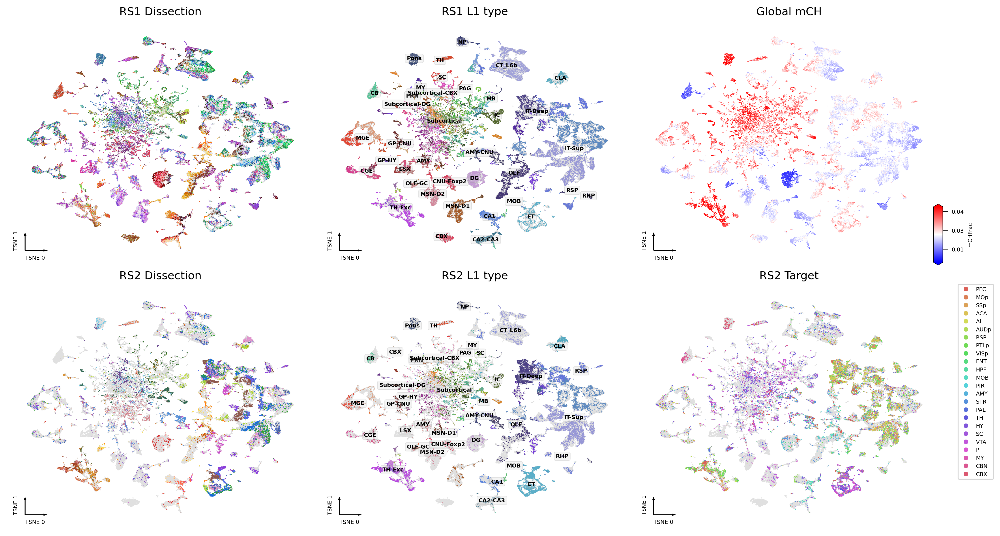

In [18]:
# L1dict = {xx:yy for yy,xx in zip(cycle(sns.color_palette('tab20')), np.sort(adata_neu.obs['L1_annot'].unique()))}

fig, axes = plt.subplots(2, 3, figsize=(15, 8), dpi=300, constrained_layout=True)
tmp = adata_neu.obs[adata_neu.obs['Study']=='CEMBA_snmC']
ax=axes[0,0]
ax.scatter(adata_neu.obs[f'{coord_base}_0'], adata_neu.obs[f'{coord_base}_1'], c='#e0e0e0', s=ds, edgecolor='none', rasterized=True)
_ = categorical_scatter(data=tmp,
                        ax=ax,
                        coord_base=coord_base,
                        hue='DissectionRegion',
                        s=ds,
                        palette=brain.get_dissection_region_palette(),
                        labelsize=6,
                        max_points=50000,
                        scatter_kws={'rasterized':True},
                        show_legend=False)

ax=axes[0,1]
ax.scatter(adata_neu.obs[f'{coord_base}_0'], adata_neu.obs[f'{coord_base}_1'], c='#e0e0e0', s=ds, edgecolor='none', rasterized=True)
_ = categorical_scatter(data=tmp,
                        ax=ax,
                        coord_base=coord_base,
                        hue='L2_annot',
                        text_anno='L1_annot',
                        s=ds,
                        palette=palette,
                        labelsize=6,
                        max_points=50000,
                        scatter_kws={'rasterized':True},
                        show_legend=False)

tmp = adata_neu.obs[adata_neu.obs['Study']=='CEMBA_EpiRetro']

ax=axes[1,1]
ax.scatter(adata_neu.obs[f'{coord_base}_0'], adata_neu.obs[f'{coord_base}_1'], c='#e0e0e0', s=ds, edgecolor='none', rasterized=True)
_ = categorical_scatter(data=tmp,
                        ax=ax,
                        coord_base=coord_base,
                        hue='L2_annot',
                        text_anno='L1_annot',
                        s=ds,
                        palette=palette,
                        labelsize=6,
                        max_points=50000,
                        scatter_kws={'rasterized':True},
                        show_legend=False)

ax=axes[1,0]
ax.scatter(adata_neu.obs[f'{coord_base}_0'], adata_neu.obs[f'{coord_base}_1'], c='#e0e0e0', s=ds, edgecolor='none', rasterized=True)
_ = categorical_scatter(data=tmp,
                        ax=ax,
                        coord_base=coord_base,
                        hue='SubRegion',
                        #text_anno='Source',
                        s=ds,
                        labelsize=6,
                        max_points=50000,
                        palette=colors,
                        scatter_kws={'rasterized':True},
                        show_legend=False)

ax=axes[1,2]
ax.scatter(adata_neu.obs[f'{coord_base}_0'], adata_neu.obs[f'{coord_base}_1'], c='#e0e0e0', s=ds, edgecolor='none', rasterized=True)
_ = categorical_scatter(data=tmp,
                        ax=ax,
                        coord_base=coord_base,
                        hue='Target',
                        #text_anno='Source',
                        s=ds,
                        labelsize=6,
                        max_points=50000,
                        palette=tarcolor,
                        scatter_kws={'rasterized':True},
                        show_legend=True,
                        legend_kws={'ncol':1}
                       )

ax = axes[0,2]
_ = continuous_scatter(data=adata_neu.obs, 
                       ax=ax, 
                       coord_base=coord_base,
                       s=ds,
                       cmap='bwr',
                       labelsize=6,
                       max_points=50000,
                       scatter_kws={'rasterized':True},
                       hue='mCHFrac')

for i,xx in enumerate(['RS1 Dissection', 'RS1 L1 type', 'Global mCH', 
                       'RS2 Dissection', 'RS2 L1 type', 'RS2 Target', 
                       ]):
    axes.flatten()[i].set_title(xx, fontsize=12)

plt.savefig(f'plot/cell_{adata_neu.shape[0]}.meta.pdf', transparent=True)
# plt.tight_layout()


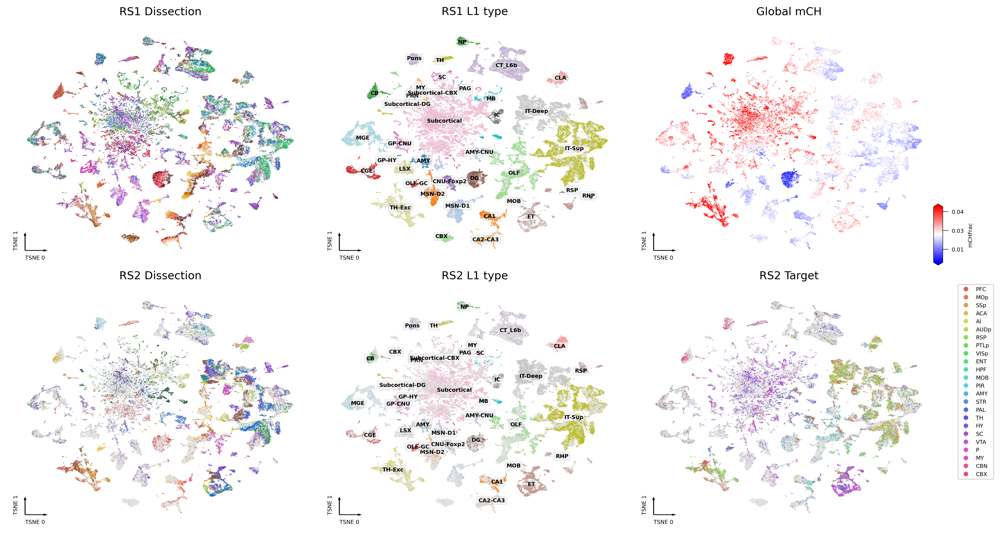

In [18]:
L1dict = {xx:yy for yy,xx in zip(cycle(sns.color_palette('tab20')), np.sort(adata_neu.obs['L1_annot'].unique()))}

fig, axes = plt.subplots(2, 3, figsize=(15, 8), dpi=300, constrained_layout=True)
tmp = adata_neu.obs[adata_neu.obs['Study']=='CEMBA_snmC']
ax=axes[0,0]
ax.scatter(adata_neu.obs[f'{cord_base}_0'], adata_neu.obs[f'{cord_base}_1'], c='#e0e0e0', s=ds, edgecolor='none', rasterized=True)
_ = categorical_scatter(data=tmp,
                        ax=ax,
                        coord_base=coord_base,
                        hue='DissectionRegion',
                        s=ds,
                        palette=brain.get_dissection_region_palette(),
                        labelsize=6,
                        max_points=50000,
                        scatter_kws={'rasterized':True},
                        show_legend=False)

ax=axes[0,1]
ax.scatter(adata_neu.obs[f'{cord_base}_0'], adata_neu.obs[f'{cord_base}_1'], c='#e0e0e0', s=ds, edgecolor='none', rasterized=True)
_ = categorical_scatter(data=tmp,
                        ax=ax,
                        coord_base=coord_base,
                        hue='L1_annot',
                        text_anno='L1_annot',
                        s=ds,
                        palette=L1dict,
                        labelsize=6,
                        max_points=50000,
                        scatter_kws={'rasterized':True},
                        show_legend=False)

tmp = adata_neu.obs[adata_neu.obs['Study']=='CEMBA_EpiRetro']

ax=axes[1,1]
ax.scatter(adata_neu.obs[f'{cord_base}_0'], adata_neu.obs[f'{cord_base}_1'], c='#e0e0e0', s=ds, edgecolor='none', rasterized=True)
_ = categorical_scatter(data=tmp,
                        ax=ax,
                        coord_base=coord_base,
                        hue='L1_annot',
                        text_anno='L1_annot',
                        s=ds,
                        palette=L1dict,
                        labelsize=6,
                        max_points=50000,
                        scatter_kws={'rasterized':True},
                        show_legend=False)

ax=axes[1,0]
ax.scatter(adata_neu.obs[f'{cord_base}_0'], adata_neu.obs[f'{cord_base}_1'], c='#e0e0e0', s=ds, edgecolor='none', rasterized=True)
_ = categorical_scatter(data=tmp,
                        ax=ax,
                        coord_base=coord_base,
                        hue='SubRegion',
                        #text_anno='Source',
                        s=ds,
                        labelsize=6,
                        max_points=50000,
                        palette=colors,
                        scatter_kws={'rasterized':True},
                        show_legend=False)

ax=axes[1,2]
ax.scatter(adata_neu.obs[f'{cord_base}_0'], adata_neu.obs[f'{cord_base}_1'], c='#e0e0e0', s=ds, edgecolor='none', rasterized=True)
_ = categorical_scatter(data=tmp,
                        ax=ax,
                        coord_base=coord_base,
                        hue='Target',
                        #text_anno='Source',
                        s=ds,
                        labelsize=6,
                        max_points=50000,
                        palette=tarcolor,
                        scatter_kws={'rasterized':True},
                        show_legend=True,
                        legend_kws={'ncol':1}
                       )

ax = axes[0,2]
_ = continuous_scatter(data=adata_neu.obs, 
                       ax=ax, 
                       coord_base=coord_base,
                       s=ds,
                       cmap='bwr',
                       labelsize=6,
                       max_points=50000,
                       scatter_kws={'rasterized':True},
                       hue='mCHFrac')

for i,xx in enumerate(['RS1 Dissection', 'RS1 L1 type', 'Global mCH', 
                       'RS2 Dissection', 'RS2 L1 type', 'RS2 Target', 
                       ]):
    axes.flatten()[i].set_title(xx, fontsize=12)

plt.savefig(f'plot/cell_{adata_neu.shape[0]}.meta.pdf', transparent=True)
# plt.tight_layout()


In [14]:
from wmb import cemba, mm10
gene_meta = mm10.get_gene_metadata(annot_version = 'GENCODE_vm23')
gene_meta

,chrom,source,feature,start,end,score,strand,phase,transcript_id,gene_type,...,transcript_type,transcript_status,transcript_name,exon_number,exon_id,level,gene_version,mgi_id,havana_gene,tag
gene_id,,,,,,,,,,,,,,,,,,,,,
ENSMUSG00000051951,chr1,HAVANA,gene,3205901,3671498,.,-,.,NaN,protein_coding,...,NaN,NaN,NaN,NaN,NaN,2,5,MGI:3528744,OTTMUSG00000026353.2,NaN
ENSMUSG00000089699,chr1,HAVANA,gene,3466587,3513553,.,+,.,NaN,lncRNA,...,NaN,NaN,NaN,NaN,NaN,2,1,MGI:3780162,OTTMUSG00000026352.1,NaN
ENSMUSG00000102331,chr1,HAVANA,gene,3647309,3658904,.,-,.,NaN,lncRNA,...,NaN,NaN,NaN,NaN,NaN,2,1,MGI:5012123,OTTMUSG00000049924.1,NaN
ENSMUSG00000102343,chr1,HAVANA,gene,3905739,3986215,.,-,.,NaN,lncRNA,...,NaN,NaN,NaN,NaN,NaN,2,1,MGI:5610609,OTTMUSG00000049934.1,NaN
ENSMUSG00000025900,chr1,HAVANA,gene,3999557,4409241,.,-,.,NaN,protein_coding,...,NaN,NaN,NaN,NaN,NaN,2,12,MGI:1341105,OTTMUSG00000049985.3,overlapping_locus
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSMUSG00000095523,JH584299.1,ENSEMBL,gene,837364,840451,.,+,.,NaN,protein_coding,...,NaN,NaN,NaN,NaN,NaN,3,1,NaN,NaN,NaN
ENSMUSG00000095475,JH584299.1,ENSEMBL,gene,910289,913083,.,-,.,NaN,protein_coding,...,NaN,NaN,NaN,NaN,NaN,3,1,NaN,NaN,NaN
ENSMUSG00000094855,JH584299.1,ENSEMBL,gene,921942,924675,.,+,.,NaN,protein_coding,...,NaN,NaN,NaN,NaN,NaN,3,1,NaN,NaN,NaN


In [38]:
ens2gene = gene_meta["gene_name"].to_dict()
gene2ens = gene_meta.reset_index().set_index("gene_name")["gene_id"].to_dict()

In [16]:
selc = adata_neu.obs.index[adata_neu.obs["Study"] == "CEMBA_snmC"]
marker = [
    "Slc17a6",
    "Slc17a7",
    "Gad1",
    "Gad2",
    "Th",
    "Slc6a5",
]

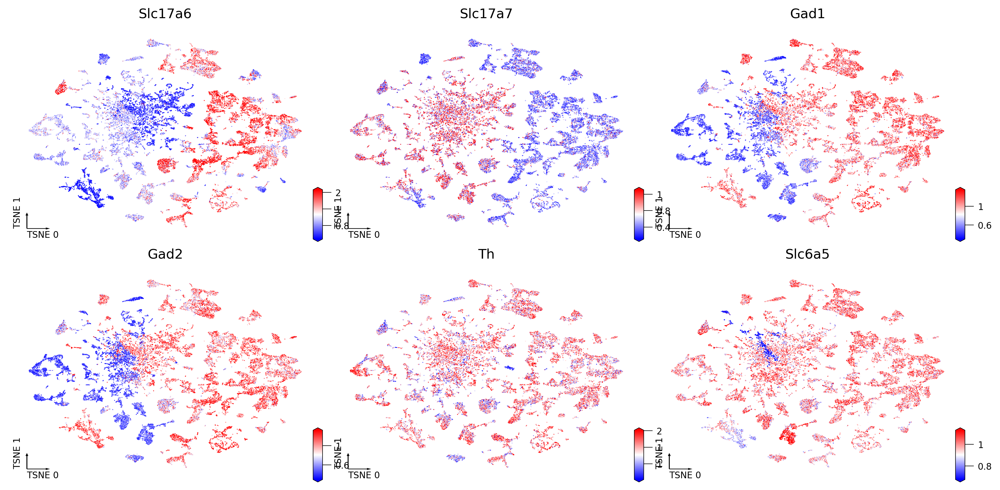

In [22]:
fig, axes = plt.subplots(2, 3, figsize=(12, 6), dpi=300, constrained_layout=True)
for xx, ax in zip(marker, axes.flatten()):
    tmp = cemba.get_mc_gene_frac(xx)
    tmp = tmp.loc[tmp.index.isin(adata_neu.obs.index)]
    _ = continuous_scatter(
        data=adata_neu.obs,
        ax=ax,
        coord_base=coord_base,
        s=ds,
        cmap="bwr",
        labelsize=8,
        max_points=50000,
        scatter_kws={"rasterized": True},
        hue=tmp,
        hue_norm=np.percentile(tmp, [1,90]),
    )
    ax.set_title(xx, fontsize=12)
    
# plt.savefig(f'cell_{adata_merge.shape[0]}_{t}_AIBS10x_CEMBAsnmC_CEMBAEpiRetro.marker_expr.pdf', transparent=True)


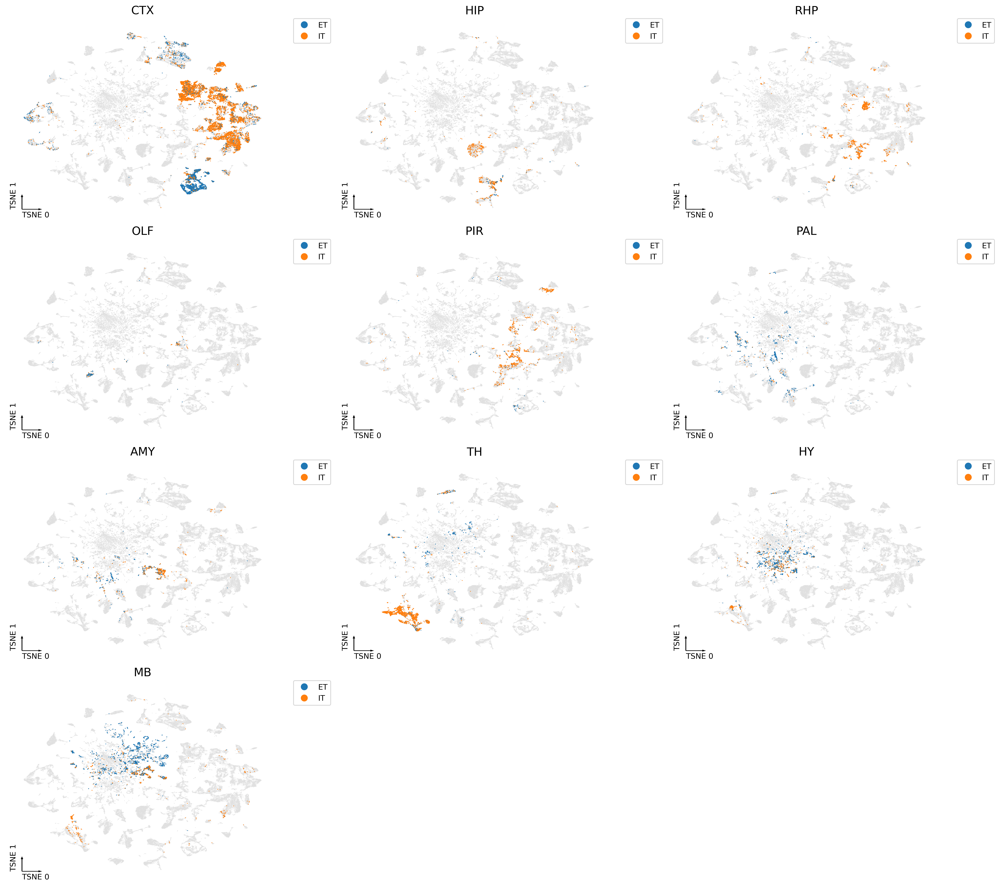

In [44]:
fig, axes = plt.subplots(4, 3, figsize=(18, 16), dpi=300, constrained_layout=True)
data = adata_neu.obs.loc[adata_neu.obs["TargetGroup"].isin(['IT', 'ET'])]
for i,xx in enumerate(reg_list):
    ax = axes.flatten()[i]
    ax.scatter(
        adata_neu.obs[f"{coord_base}_0"],
        adata_neu.obs[f"{coord_base}_1"],
        c="#e0e0e0",
        edgecolors="none",
        s=ds,
        alpha=0.5,
        rasterized=True,
    )
    tmp = data.loc[data['MajorRegion']==xx]
    _ = categorical_scatter(
        data=tmp,
        ax=ax,
        coord_base=coord_base,
        s=ds * 5,
        hue="TargetGroup",
        palette="tab10",
        labelsize=10,
        max_points=None,
        scatter_kws={"rasterized": True},
        show_legend=True,
        outline=None,
        legend_kws = {'ncol':1, 'fontsize':10}
    )
    ax.set_title(xx, fontsize=15)
    
for ax in axes.flatten()[len(reg_list):]:
    ax.axis('off')


In [42]:
reg_list = []
for xx in rs2_subregion_dict:
    count = adata_neu.obs.loc[(adata_neu.obs['TargetGroup'].isin(['IT', 'ET'])) & (adata_neu.obs['SubRegion']==xx), 'TargetGroup'].value_counts()
    if count.shape[0]==2:
        reg_list.append(xx)

print(len(reg_list))


23


In [50]:
fig, axes = plt.subplots(8, 3, figsize=(18, 32), dpi=300, constrained_layout=True)
data = adata_neu.obs.loc[adata_neu.obs["TargetGroup"].isin(['IT', 'ET'])]
for i,xx in enumerate(reg_list):
    ax = axes.flatten()[i]
    ax.scatter(
        adata_neu.obs[f"{coord_base}_0"],
        adata_neu.obs[f"{coord_base}_1"],
        c="#e0e0e0",
        edgecolors="none",
        s=ds,
        alpha=0.5,
        rasterized=True,
    )
    tmp = data.loc[data['SubRegion']==xx]
    _ = categorical_scatter(
        data=tmp,
        ax=ax,
        coord_base=coord_base,
        s=ds * 5,
        hue="TargetGroup",
        palette="tab10",
        labelsize=10,
        max_points=None,
        scatter_kws={"rasterized": True},
        show_legend=True,
        outline=None,
        legend_kws = {'ncol':1, 'fontsize':10}
    )
    ax.set_title(xx, fontsize=15)
    
for ax in axes.flatten()[len(reg_list):]:
    ax.axis('off')

plt.savefig(f'plot/cell_{adata_neu.shape[0]}_subregion_ITvsET.pdf', transparent=True)


In [62]:
adata_neu.write_h5ad(f'cell_{adata_neu.shape[0]}_Neu_RS1RS2_mCHmCG.h5ad')


In [42]:
reg_group = {'CTX': ['MOp', 'SSp', 'ACA', 'AI', 'RSP', 'AUD', 'PTLp', 'VIS'], 
             'RHP': ['ENT'], 
             'PIR': ['PIRa', 'PIRp'],
             'OLF': ['MOB', 'AON'],
             'HIP': ['CAp'],
             'PAL': ['PAL'],
             'AMY': ['AMY'],
             'TH': ['THl', 'THp'],
             'HY': ['HY'],
             'MB': ['MRN', 'VTA', 'PAG'],
            }
regmap = {xx:yy for yy in reg_group for xx in reg_group[yy]}


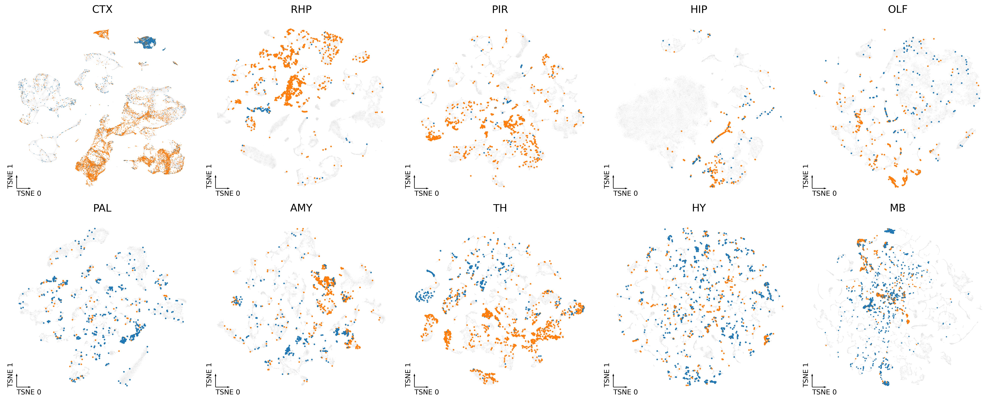

In [40]:
fig, axes = plt.subplots(2, 5, figsize=(20, 8), dpi=300, constrained_layout=True)
for i,xx in enumerate(reg_group):
    data = anndata.read_h5ad(glob(f'/home/jzhou_salk_edu/sky_workdir/221122-cemba-tenx-integration/{xx}/{xx}_*_rs1rs2rna.h5ad')[0])
    ax = axes.flatten()[i]
    ax.scatter(
        data.obs[f"{coord_base}_0"],
        data.obs[f"{coord_base}_1"],
        c="#e0e0e0",
        edgecolors="none",
        s=10000/data.shape[0],
        alpha=0.5,
        rasterized=True,
    )
    tmp = data.obs.loc[data.obs['Study']=='CEMBA_EpiRetro']
    tmp[['TargetGroup', 'SubRegion']] = adata_neu.obs.loc[tmp.index, ['TargetGroup', 'SubRegion']].values
    tmp = tmp.loc[(tmp['SubRegion'].isin(reg_group[xx])) & (tmp['TargetGroup'].isin(['IT', 'ET']))]
    _ = categorical_scatter(
        data=tmp,
        ax=ax,
        coord_base=coord_base,
        s=min(5, 10000/tmp.shape[0]),
        hue="TargetGroup",
        palette={'ET':'C0', 'IT':'C1'},
        labelsize=10,
        max_points=None,
        scatter_kws={"rasterized": True},
        show_legend=False,
        outline=None,
        # legend_kws = {'ncol':1, 'fontsize':10}
    )
    ax.set_title(xx, fontsize=15)

# for ax in axes.flatten()[len(reg_list):]:
#     ax.axis('off')

plt.savefig(f'plot/cell_{adata_neu.shape[0]}_regiongroup_ITvsET.pdf', transparent=True)


In [44]:
reg_group = {'CTX': ['MOp', 'SSp', 'ACA', 'AI', 'RSP', 'AUD', 'PTLp', 'VIS', 'ENT', 'PIRa', 'PIRp'],
             'HIP': ['CAp'],
             'OLF': ['MOB', 'AON'],
             'PAL': ['PAL'],
             'AMY': ['AMY'],
             'TH': ['THl', 'THp'],
             'HY': ['HY'],
             'MB': ['MRN', 'VTA', 'PAG'],
            }
regmap = {xx:yy for yy in reg_group for xx in reg_group[yy]}


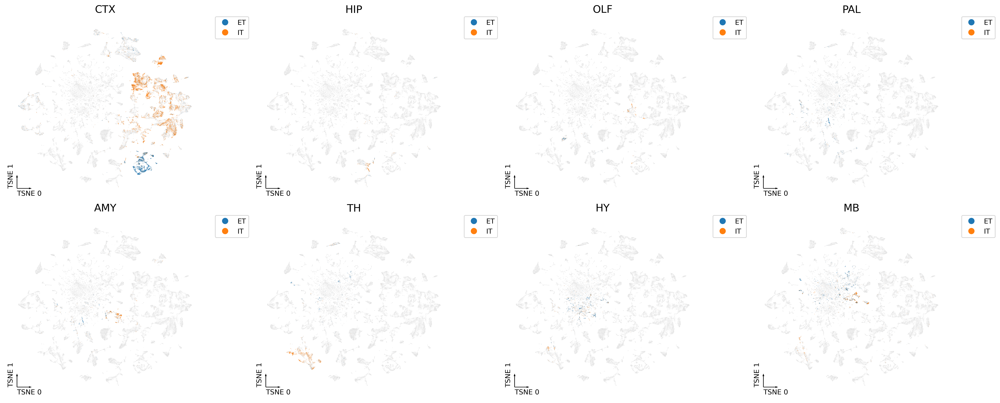

In [46]:
data = adata_neu.obs.loc[adata_neu.obs["TargetGroup"].isin(['IT', 'ET']) & adata_neu.obs['SubRegion'].isin(regmap.keys())]
data['SourceGroup'] = data['SubRegion'].map(regmap)

fig, axes = plt.subplots(2, 4, figsize=(20, 8), dpi=300, constrained_layout=True)
for i,xx in enumerate(reg_group):
    ax = axes.flatten()[i]
    ax.scatter(
        adata_neu.obs[f"{coord_base}_0"],
        adata_neu.obs[f"{coord_base}_1"],
        c="#e0e0e0",
        edgecolors="none",
        s=ds,
        alpha=0.5,
        rasterized=True,
    )
    tmp = data.loc[data['SourceGroup']==xx]
    _ = categorical_scatter(
        data=tmp,
        ax=ax,
        coord_base=coord_base,
        s=ds * 2,
        hue="TargetGroup",
        palette="tab10",
        labelsize=10,
        max_points=None,
        scatter_kws={"rasterized": True},
        show_legend=True,
        outline=None,
        legend_kws = {'ncol':1, 'fontsize':10}
    )
    ax.set_title(xx, fontsize=15)
    
for ax in axes.flatten()[len(reg_group):]:
    ax.axis('off')

plt.savefig(f'plot/cell_{adata_neu.shape[0]}_regiongroup_ITvsET.pdf', transparent=True)


In [4]:
notebook_snakemake(
    work_dir=f"/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/result/run/",
    notebook_dir="/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/template_leave1target/",
    groups=list(rs1_subregion_dict.keys()),
    default_cpu=1,
    default_mem_gb=1,
    redo_prepare=True,
)

In [4]:
result = []
for xx in rs1_subregion_dict.keys():
    result.append(
        pd.read_hdf(
            f"/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/result/{xx}-leave1target.hdf"
        )
    )

result = pd.concat(result, axis=0)[tarall]

In [5]:
result = result[(~result.isna()).sum(axis=1) > 0]
result

,PFC,MOp,SSp,ACA,AI,AUDp,RSP,PTLp,VISp,MOB,...,AMY,STR,PAL,TH,HY,SC,VTA,P,MY,All
MOp,NaN,NaN,0.948998,0.949091,0.890511,0.933333,NaN,NaN,NaN,NaN,...,NaN,0.885375,NaN,0.677966,NaN,0.937500,0.605469,0.876404,0.937500,0.881726
SSp,NaN,0.916996,NaN,0.718147,NaN,1.000000,0.987616,0.983425,NaN,NaN,...,NaN,0.813953,NaN,0.597087,NaN,0.855346,0.784615,0.880000,0.553333,0.892977
ACA,0.914439,0.925000,0.804348,NaN,0.983146,0.947368,0.910035,0.946058,0.868852,NaN,...,0.883721,0.855615,NaN,0.722628,NaN,0.759259,0.633188,0.751174,NaN,0.878096
AI,0.963855,0.963636,0.958678,0.981481,NaN,1.000000,1.000000,1.000000,0.992063,NaN,...,NaN,0.899281,NaN,0.550000,0.756098,0.844560,NaN,0.927184,0.787234,0.933069
RSP,NaN,0.844828,0.690909,0.743697,NaN,0.715909,NaN,0.777143,0.710145,NaN,...,NaN,NaN,NaN,0.447154,NaN,0.323308,NaN,0.472826,NaN,0.639348
AUD,NaN,1.000000,0.930070,0.877934,NaN,NaN,0.937173,0.918552,0.973568,NaN,...,NaN,0.899408,NaN,0.565714,NaN,0.646825,NaN,0.830116,NaN,0.873434
PTLp,NaN,0.970803,0.946667,0.983051,NaN,0.976667,0.948207,NaN,0.962963,NaN,...,NaN,0.836364,NaN,0.613260,NaN,0.787879,NaN,0.751412,0.555556,0.865180
VIS,NaN,NaN,0.741935,0.715447,NaN,0.909910,0.977578,0.931579,NaN,NaN,...,NaN,0.809816,NaN,0.648402,NaN,0.519380,NaN,0.735178,NaN,0.789909
ENT,0.988930,0.909091,NaN,0.986301,NaN,NaN,0.980892,0.993976,NaN,NaN,...,NaN,0.992063,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
CAp,NaN,NaN,NaN,NaN,NaN,NaN,0.416667,NaN,NaN,0.823529,...,NaN,0.637931,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


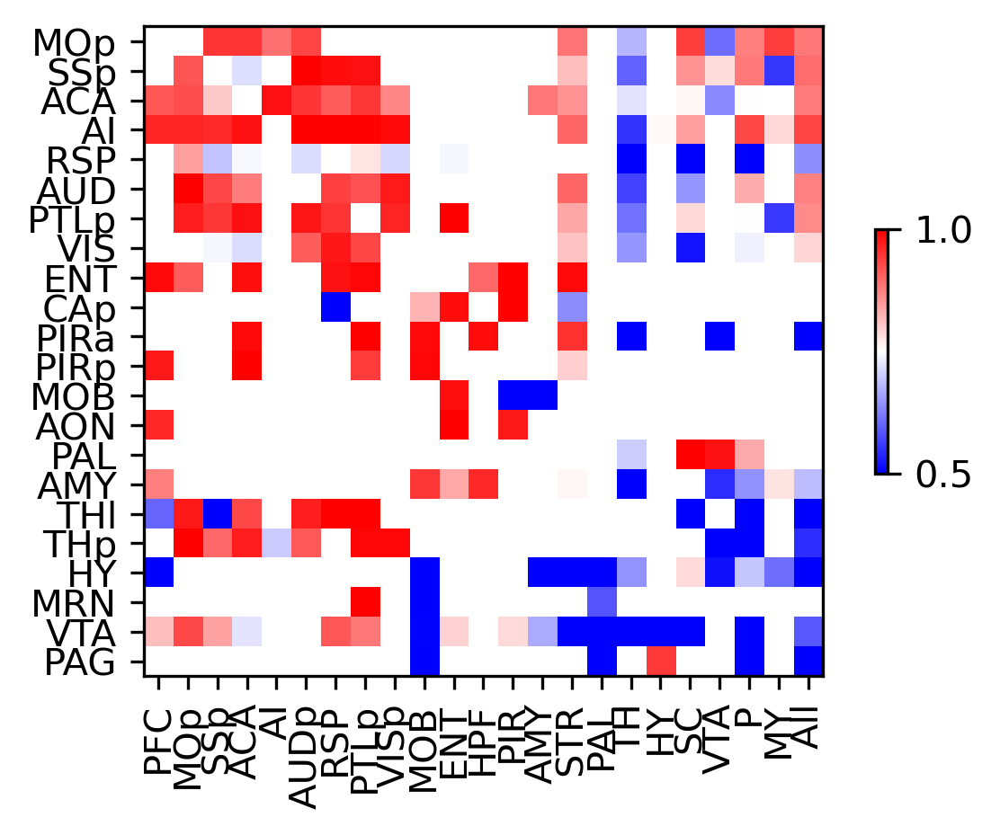

In [13]:
fig, ax = plt.subplots(figsize=(5, 4), dpi=300)
# sns.heatmap(result, ax=ax, cmap='bwr')
plot = ax.imshow(result, cmap="bwr", vmin=0.5, vmax=1)
ax.set_xticks(np.arange(result.shape[1]))
ax.set_xticklabels(result.columns, rotation=90, ha="center")
ax.set_yticks(np.arange(result.shape[0]))
ax.set_yticklabels(result.index)
cbar = plt.colorbar(plot, ax=ax, shrink=0.3, fraction=0.3)
cbar.set_ticks([cbar.vmin, cbar.vmax])

In [20]:
count = []
for xx in source_list:
    adata = anndata.read_h5ad(
        f"/home/jzhou_salk_edu/sky_workdir/230129_targetpair_roc/data/{xx}_RS2_geneCH.h5ad"
    )
    print(adata.shape)
    adata.obs["TargetType"] = adata.obs["Target"].map(tarmap)
    count.append(adata.obs["TargetType"].value_counts())

count = pd.concat(count, axis=1).T
count.index = source_list
count

(2568, 9906)
(2204, 9906)
(2520, 9906)
(1922, 9906)
(1509, 9906)
(2016, 9906)
(1969, 9906)
(1836, 9906)
(1509, 9906)
(498, 9906)
(467, 9906)
(324, 9906)
(281, 9906)
(681, 9906)
(1425, 9906)
(798, 9906)
(910, 9906)
(1538, 9906)
(567, 9906)
(2045, 9906)
(497, 9906)
(159, 9906)


,ET,IT
MOp,1159,1409
SSp,989,1215
ACA,795,1725
AI,567,1355
RSP,573,936
AUD,686,1330
PTLp,634,1335
VIS,730,1106
ENT,112,1397
PIRa,60,438


In [7]:
source_list = []
for xx in rs1_subregion_dict.keys():
    adata = anndata.read_h5ad(
        f"/home/jzhou_salk_edu/sky_workdir/230129_targetpair_roc/data/{xx}_RS2_geneCH.h5ad"
    )
    print(adata.shape)
    adata.obs["TargetType"] = adata.obs["Target"].map(tarmap)
    target_it = [
        xx
        for xx in tarall
        if xx in adata.obs.loc[adata.obs["TargetType"] == "IT", "Target"].values
    ]
    target_et = [
        xx
        for xx in tarall
        if xx in adata.obs.loc[adata.obs["TargetType"] == "ET", "Target"].values
    ]
    if len(target_it) > 0 and len(target_et) > 0:
        source_list.append(xx)

(2568, 9906)
(2204, 9906)
(2520, 9906)
(1922, 9906)
(1509, 9906)
(2016, 9906)
(1969, 9906)
(1836, 9906)
(1509, 9906)
(93, 9906)
(443, 9906)
(66, 9906)
(236, 9906)
(498, 9906)
(467, 9906)
(324, 9906)
(281, 9906)
(681, 9906)
(194, 9906)
(1425, 9906)
(798, 9906)
(665, 9906)
(910, 9906)
(1538, 9906)
(507, 9906)
(567, 9906)
(2045, 9906)
(497, 9906)
(159, 9906)
(1099, 9906)
(1302, 9906)


In [23]:
source_list = [
    "MOp",
    "SSp",
    "ACA",
    "AI",
    "RSP",
    "AUD",
    "PTLp",
    "VIS",
    "ENT",
    "PIRa",
    "PIRp",
    "MOB",
    "AON",
    "CAp",
    "PAL",
    "AMY",
    "THl",
    "THp",
    "HY",
    "MRN",
    "VTA",
    "PAG",
    # "IC",
]
print(len(source_list))

22


In [45]:
from wmb import brain
colors = pd.read_csv('/cemba/CEMBA_RS2/source_palette.tsv', header=0, index_col=0, sep='\t')
colors = colors[['RegionGroup', 'RegionGroupColor']].drop_duplicates().set_index('RegionGroup')['RegionGroupColor']
colors['LSX'] = brain.get_sub_region_palette()['LSX']
colors = colors.loc[reg_group.keys()].to_dict()


In [46]:
offset = [0]
for xx in reg_group:
    offset.append(offset[-1]+len(reg_group[xx]))
    
offset = np.array(offset)

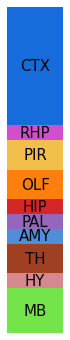

In [47]:
import matplotlib.patches as patches

fig, ax = plt.subplots(figsize=(1,6))
ax.axis('off')
for i,xx in enumerate(colors):
    rect = patches.Rectangle((0, offset[i]), 1, offset[i+1]-offset[i], linewidth=0, edgecolor='none', facecolor=colors[xx])
    ax.add_patch(rect)
    ax.text(0.5, np.mean(offset[i:(i+2)]), xx, fontsize=15, horizontalalignment='center', verticalalignment='center')
    
ax.set_xlim([0,1])
ax.set_ylim([offset[-1], offset[0]])
plt.savefig('plot/regiongroup_color.pdf', transparent=True)


In [13]:
notebook_snakemake(
    work_dir=f"/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/result/in_source/",
    notebook_dir="/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/template_insource/",
    groups=source_list,
    default_cpu=1,
    default_mem_gb=1,
    redo_prepare=True,
)

In [10]:
result = []
for xx in source_list:
    tmp1 = pd.read_hdf(f"/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/result/{xx}-biorep_mean.hdf")
    tmp2 = pd.read_hdf(f"/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/result/{xx}-comprep_mean.hdf")
    if tmp1.shape[0]>1:
        result.append([tmp1.loc['IT','ET'], tmp2.loc['IT','ET']])
    else:
        result.append([np.nan, tmp2.loc['IT','ET']])

result = pd.DataFrame(result, index=source_list, columns=['biorep', 'comprep'])
result

,biorep,comprep
MOp,0.935705,0.949113
SSp,0.952076,0.955355
ACA,0.924577,0.927922
AI,0.963389,0.963450
RSP,0.848352,0.859122
AUD,0.927589,0.936028
PTLp,0.924359,0.917430
VIS,0.907459,0.912818
ENT,0.776389,0.915519
PIRa,NaN,0.833402


In [34]:
# colors = pd.read_csv('/cemba/CEMBA_RS2/source_id.txt', header=None, index_col=0, sep='\t', names=['L1reg', 'L2reg', 'L1color', 'L2color'])
# colors = {xx:yy for xx,yy in colors.values[:, [0,2,1,3]].reshape((-1,2))}


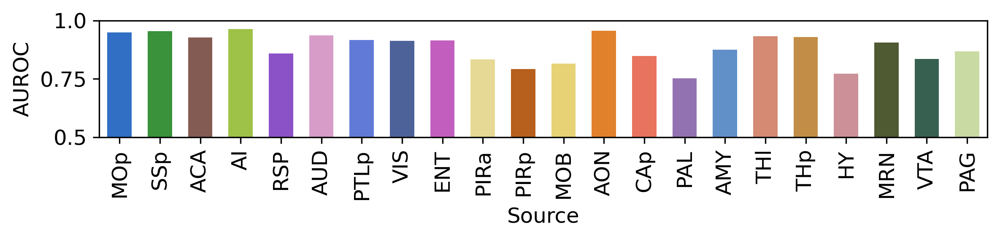

In [51]:
fig, ax = plt.subplots(figsize=(8,2), dpi=300)
sns.barplot(data=result.reset_index(), x='index', y='comprep', width=0.6, palette=colors, order=source_list, ax=ax)
# ax.legend().remove()
ax.set_xlabel('Source', fontsize=12)
ax.set_ylabel('AUROC', fontsize=12)
ax.set_xticklabels(ax.get_xticklabels(), rotation=90, ha='center', fontsize=12)
ax.set_ylim([0.5, 1])
ax.set_yticks([0.5, 0.75, 1.0])
ax.set_yticklabels([0.5, 0.75, 1.0], fontsize=12)
plt.tight_layout()
plt.savefig('plot/insource_roc_ITvsET.pdf', transparent=True)


In [12]:
result_tmp = result.copy()

In [13]:
notebook_snakemake(
    work_dir=f"/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/result/cross_source/",
    notebook_dir="/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/template_crosssource/",
    groups=source_list,
    default_cpu=1,
    default_mem_gb=1,
    redo_prepare=True,
)

In [105]:
result = []
for xx in source_list:
    result.append(
        pd.read_hdf(
            f"/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/result/{xx}-crosssource.hdf"
        )
    )

result = pd.concat(result, axis=0).loc[source_list, source_list]
result

,MOp,SSp,ACA,AI,RSP,AUD,PTLp,VIS,ENT,PIRa,...,AON,CAp,PAL,AMY,THl,THp,HY,MRN,VTA,PAG
MOp,NaN,0.908053,0.895174,0.938520,0.788406,0.883621,0.899034,0.887391,0.795084,0.791553,...,0.370555,0.556772,0.380842,0.565683,0.467630,0.530440,0.487068,0.479530,0.486168,0.417414
SSp,0.924003,NaN,0.870938,0.817016,0.767051,0.886118,0.856651,0.883233,0.775763,0.603539,...,0.180129,0.489186,0.370338,0.290859,0.507120,0.696653,0.560872,0.521500,0.523454,0.394653
ACA,0.925270,0.884732,NaN,0.909242,0.833322,0.859729,0.888320,0.873150,0.857469,0.683600,...,0.465165,0.567650,0.349441,0.611381,0.691065,0.795869,0.620261,0.606459,0.564703,0.435179
AI,0.914325,0.878402,0.910007,NaN,0.807213,0.878736,0.873806,0.883766,0.784008,0.752854,...,0.398311,0.568237,0.472461,0.483587,0.534532,0.579500,0.545420,0.501653,0.542482,0.470924
RSP,0.904114,0.839944,0.902675,0.924545,NaN,0.834237,0.903745,0.840848,0.806051,0.738546,...,0.568705,0.617777,0.576663,0.548295,0.571037,0.436401,0.555004,0.607349,0.539326,0.549300
AUD,0.919341,0.924196,0.889431,0.916006,0.765265,NaN,0.897648,0.909807,0.766898,0.703234,...,0.312309,0.462511,0.388215,0.447788,0.484872,0.466838,0.558048,0.412638,0.563115,0.428116
PTLp,0.934956,0.906239,0.909279,0.931705,0.838530,0.891513,NaN,0.884917,0.855174,0.783600,...,0.394047,0.666764,0.428646,0.542315,0.518016,0.659330,0.515471,0.620852,0.487113,0.504367
VIS,0.908004,0.933716,0.894564,0.892986,0.777642,0.920324,0.872423,NaN,0.795940,0.666248,...,0.248833,0.496808,0.372683,0.313083,0.517780,0.394116,0.495252,0.301157,0.459019,0.358023
ENT,0.926810,0.906772,0.909312,0.894542,0.787274,0.842193,0.884443,0.860901,NaN,0.737443,...,0.560257,0.390072,0.367501,0.637884,0.580280,0.643619,0.606972,0.462250,0.498984,0.380351
PIRa,0.944298,0.894725,0.904811,0.949174,0.809693,0.878301,0.891779,0.893066,0.782384,NaN,...,0.230008,0.443782,0.376390,0.637384,0.546977,0.774329,0.577880,0.650617,0.529517,0.506846


In [38]:
for xx in source_list:
    result.loc[xx, xx] = result_tmp.loc[xx, 'comprep']
    

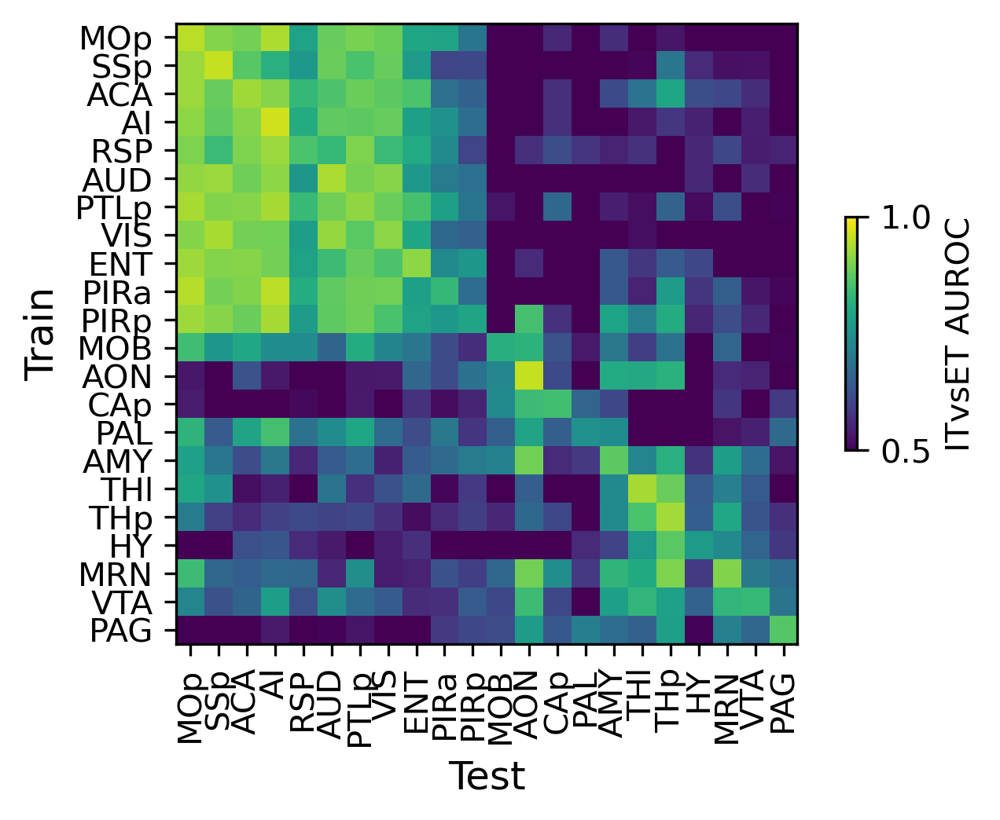

In [39]:
fig, ax = plt.subplots(figsize=(5, 4), dpi=300)
# sns.heatmap(result, ax=ax, cmap='bwr', vmin=0.5, vmax=1.0)
plot = ax.imshow(result, cmap="viridis", vmin=0.5, vmax=1)
ax.set_xticks(np.arange(result.shape[1]))
ax.set_xticklabels(result.columns, rotation=90, ha="center")
ax.set_yticks(np.arange(result.shape[0]))
ax.set_yticklabels(result.index)
ax.set_xlabel('Test', fontsize=12)
ax.set_ylabel('Train', fontsize=12)
cbar = plt.colorbar(plot, ax=ax, shrink=0.3, fraction=0.3)
cbar.set_ticks([cbar.vmin, cbar.vmax])
cbar.set_label('ITvsET AUROC')
plt.tight_layout()
plt.savefig('plot/crosssource_roc_ITvsET.pdf', transparent=True)


In [5]:
notebook_snakemake(
    work_dir=f"/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/result/diff_gene/",
    notebook_dir="/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/template_diffgene/",
    groups=source_list,
    default_cpu=1,
    default_mem_gb=1,
    redo_prepare=True,
)

In [52]:
result_fc, result_pv, result_roc = [], [], []
for reg in source_list:
    tmp = pd.read_hdf(f'/home/jzhou_salk_edu/sky_workdir/230203_ITvsET/result/{reg}-diffgene.hdf', key='data')
    result_fc.append(tmp['log2FC'])
    result_pv.append(tmp['FDR'])
    result_roc.append(tmp['AUROC'])

result_fc = pd.concat(result_fc, axis=1)
result_pv = pd.concat(result_pv, axis=1)
result_roc = pd.concat(result_roc, axis=1)


In [53]:
for xx in result_fc, result_pv, result_roc:
    xx.columns = source_list


In [54]:
for xx in source_list:
    print(xx, np.sum(result_pv[xx]<0.01), np.sum(result_fc[xx].abs()>0.5), np.sum((result_pv[xx]<0.01) & (result_fc[xx].abs()>0.5)), np.sum((result_roc[xx] - 0.5).abs()>0.25))
    

MOp 8140 672 672 794
SSp 8199 615 615 641
ACA 7302 425 425 503
AI 7770 935 934 1091
RSP 5835 177 177 99
AUD 7544 489 489 470
PTLp 7015 320 320 375
VIS 7197 300 300 297
ENT 2201 132 128 37
PIRa 732 184 99 11
PIRp 6 32 3 0
MOB 2132 303 294 16
AON 4162 1283 1266 772
CAp 659 42 33 1
PAL 435 37 9 0
AMY 4939 112 112 18
THl 5052 526 513 316
THp 6327 797 794 743
HY 1581 6 6 0
MRN 2703 64 63 9
VTA 2710 5 5 0
PAG 222 10 6 1


### DMG FC

In [82]:
data = []
offset = [0]
for reg in source_list:
    selg = (result_fc[reg].abs()>0.5) & (result_pv[reg]<0.01)
    idx = np.argsort(result_fc.loc[selg, reg])
    data.append(result_fc.loc[selg].iloc[idx])
    offset.append(offset[-1] + selg.sum())

data = pd.concat(data, axis=0)
data

,MOp,SSp,ACA,AI,RSP,AUD,PTLp,VIS,ENT,PIRa,...,AON,CAp,PAL,AMY,THl,THp,HY,MRN,VTA,PAG
geneslop2k,,,,,,,,,,,,,,,,,,,,,
ENSMUSG00000051401,-1.352673,-0.861197,-0.527993,-1.263054,-0.365395,-0.781030,-0.688733,-0.260344,-0.250233,-0.530807,...,-0.414239,0.215087,0.131440,-0.167098,-0.313755,-0.496459,-0.058124,0.107336,0.092134,0.056774
ENSMUSG00000062296,-1.321324,-1.074885,0.055851,-1.102405,0.162905,-1.104369,-0.043940,-0.394560,-0.222266,-0.320535,...,-0.271605,0.456462,-0.114875,-0.115940,-0.042500,0.352370,-0.007270,0.238877,0.137139,-0.036933
ENSMUSG00000058975,-1.284230,-1.242635,-0.575807,-1.402427,-0.571671,-0.957346,-0.913853,-0.924068,-0.936607,-0.566367,...,0.249994,-0.403388,-0.084112,0.277679,0.185374,-1.303467,0.150728,0.098511,0.161620,0.030489
ENSMUSG00000030839,-1.274507,-1.228106,-0.742580,-1.568167,-0.603634,-1.119691,-1.024058,-1.037539,-0.832418,-0.658929,...,0.535654,-0.088114,-0.098432,0.287893,0.168661,-0.671134,0.100989,0.017076,0.147336,0.127483
ENSMUSG00000032500,-1.197151,-0.969200,-0.010080,-0.633973,0.226585,-0.603721,-0.070416,-0.212916,-0.310825,-0.280284,...,-0.068002,0.067871,0.121529,-0.285228,-0.126329,-0.032540,-0.134376,-0.222761,0.014313,0.162158
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSMUSG00000008489,0.828682,0.773828,0.373362,0.460895,0.150983,0.633718,0.593107,0.469538,-0.557912,0.247335,...,-0.675245,0.055576,0.029800,0.286049,-0.568043,-0.862580,-0.218049,-0.195932,-0.257640,-0.547610
ENSMUSG00000018983,0.051158,0.013919,0.043443,-0.002806,0.040241,-0.069358,0.054012,0.017375,0.003725,0.023902,...,-0.145190,-0.206657,0.081566,-0.064888,-0.117930,-0.074194,-0.089761,-0.241821,-0.215158,-0.538017
ENSMUSG00000020811,-0.037911,-0.073756,-0.317552,0.196640,-0.034012,0.038766,-0.008253,-0.229149,-0.318643,0.045693,...,-0.026804,0.554742,-0.187388,-0.094606,-0.153457,-0.470546,-0.025532,0.063298,0.304015,0.505866


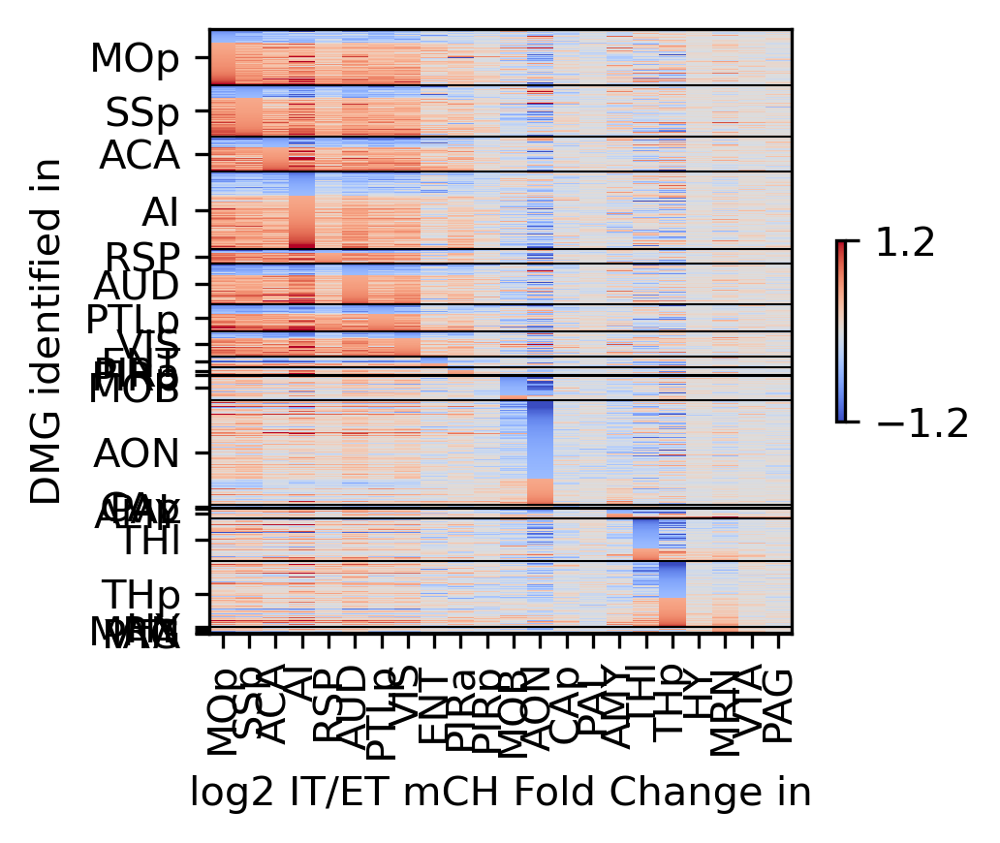

In [83]:
fig, ax = plt.subplots(figsize=(4,3), dpi=300)
plot = ax.imshow(data, vmin=-1.2, vmax=1.2, aspect='auto', cmap='coolwarm', interpolation='none', rasterized=True)
ax.set_xticks(np.arange(len(source_list)))
ax.set_xticklabels(source_list, rotation=90)
ax.set_ylabel('DMG identified in')
ax.set_xlabel('log2 IT/ET mCH Fold Change in')
yticks = []
for i in range(len(source_list)):
    # ax.plot([i-0.5,i-0.5], [offset[i], offset[i+1]], 'w')
    # ax.plot([i+0.5,i+0.5], [offset[i], offset[i+1]], 'w')
    # ax.plot([i-0.5,i+0.5], [offset[i], offset[i]], 'w')
    # ax.plot([i-0.5,i+0.5], [offset[i+1], offset[i+1]], 'w')
    ax.plot([-0.5, data.shape[1]-0.5], [offset[i+1], offset[i+1]], 'k', linewidth=0.5)
    yticks.append((offset[i+1]+offset[i]) // 2)
    
ax.set_xlim([-0.5, data.shape[1]-0.5])
ax.set_ylim([data.shape[0]-0.5, -0.5])
ax.set_yticks(yticks)
ax.set_yticklabels(source_list)

cbar = plt.colorbar(plot, ax=ax, shrink=0.3, fraction=0.3)
cbar.set_ticks([cbar.vmin, cbar.vmax])
plt.tight_layout()
# cbar.set_label('log2 Fold Change (log2 IT/ET)')
plt.savefig('plot/DMG_FC_crosssource.pdf', transparent=True)


In [86]:
selg = pd.Series(False, index=result.index)
for reg in source_list:
    selg = selg | (result_fc[reg].abs()>0.5) & (result_pv[reg]<0.01)

data = result_fc.loc[selg]
data.shape

(2919, 22)

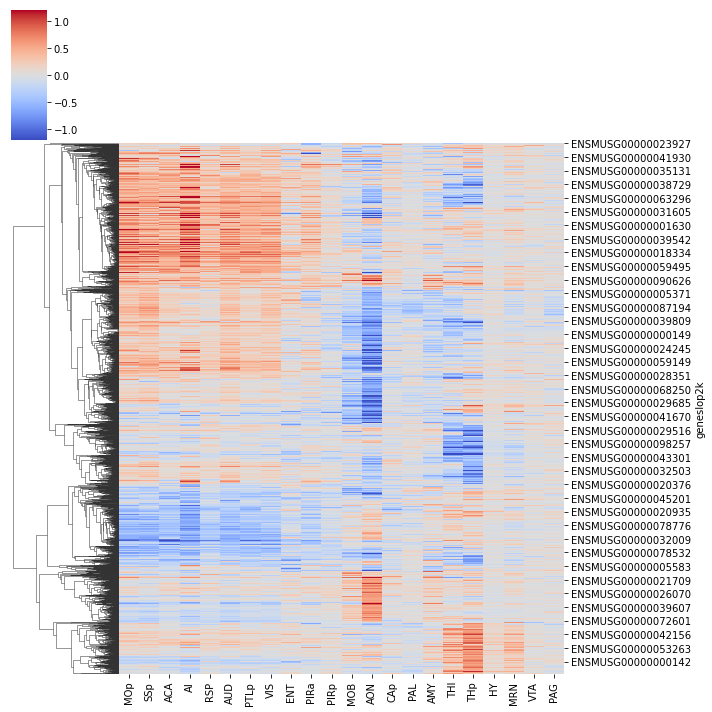

In [92]:
cg = sns.clustermap(data, vmin=-1.2, vmax=1.2, col_cluster=False, cmap='coolwarm', metric='cosine')


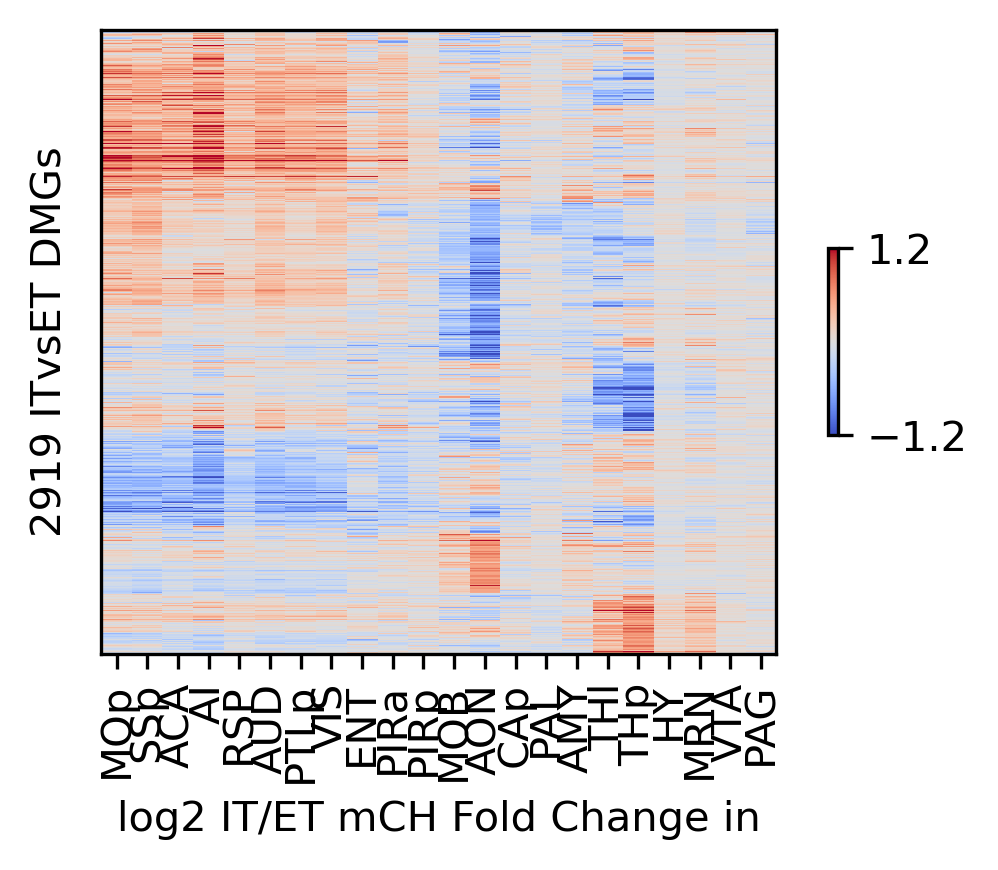

In [95]:
fig, ax = plt.subplots(figsize=(4,3), dpi=300)
plot = ax.imshow(data.iloc[cg.dendrogram_row.reordered_ind], vmin=-1.2, vmax=1.2, aspect='auto', cmap='coolwarm', interpolation='none', rasterized=True)
ax.set_xticks(np.arange(len(source_list)))
ax.set_xticklabels(source_list, rotation=90)
ax.set_ylabel(f'{selg.sum()} ITvsET DMGs')
ax.set_xlabel('log2 IT/ET mCH Fold Change in')

ax.set_xlim([-0.5, data.shape[1]-0.5])
ax.set_ylim([data.shape[0]-0.5, -0.5])
ax.set_yticks([])
# ax.set_yticklabels(source_list)

cbar = plt.colorbar(plot, ax=ax, shrink=0.3, fraction=0.3)
cbar.set_ticks([cbar.vmin, cbar.vmax])
plt.tight_layout()
# cbar.set_label('log2 Fold Change (log2 IT/ET)')
plt.savefig('plot/DMG_FC_allsource.pdf', transparent=True)


### DMG ROC

In [96]:
data = []
offset = [0]
for reg in source_list:
    selg = ((result_roc[reg] - 0.5).abs()>0.25)
    idx = np.argsort(result_roc.loc[selg, reg])[::-1]
    data.append(result_roc.loc[selg].iloc[idx])
    offset.append(offset[-1] + selg.sum())

data = 1-pd.concat(data, axis=0)
data

,MOp,SSp,ACA,AI,RSP,AUD,PTLp,VIS,ENT,PIRa,...,AON,CAp,PAL,AMY,THl,THp,HY,MRN,VTA,PAG
geneslop2k,,,,,,,,,,,,,,,,,,,,,
ENSMUSG00000051401,0.092688,0.211294,0.213664,0.090639,0.286297,0.226113,0.205440,0.359269,0.372162,0.269273,...,0.334835,0.544020,0.547586,0.440798,0.403761,0.312563,0.467012,0.559307,0.555993,0.543447
ENSMUSG00000058248,0.100105,0.210148,0.114594,0.119235,0.189313,0.283147,0.151433,0.203626,0.291652,0.288280,...,0.346098,0.416390,0.542558,0.511314,0.803216,0.588838,0.565356,0.645022,0.472772,0.575494
ENSMUSG00000030839,0.102244,0.144673,0.177159,0.066651,0.264173,0.169204,0.171396,0.158815,0.322247,0.320148,...,0.686364,0.480816,0.473739,0.674110,0.641672,0.312863,0.562953,0.504539,0.562709,0.524797
ENSMUSG00000021684,0.103344,0.235057,0.200696,0.101389,0.312803,0.266411,0.249813,0.295894,0.455881,0.229490,...,0.682140,0.379878,0.547242,0.663128,0.806366,0.661973,0.575537,0.638245,0.556801,0.627233
ENSMUSG00000056900,0.106010,0.167176,0.147673,0.090034,0.275702,0.164760,0.178196,0.177608,0.458125,0.341895,...,0.518383,0.372777,0.515504,0.622765,0.330185,0.492223,0.514427,0.613045,0.520523,0.539345
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ENSMUSG00000021047,0.565739,0.458750,0.691168,0.651510,0.517646,0.528927,0.490411,0.520759,0.504912,0.646404,...,0.675141,0.593414,0.524871,0.727563,0.767848,0.734284,0.659755,0.765588,0.650959,0.576291
ENSMUSG00000021838,0.546228,0.480885,0.547815,0.682211,0.500469,0.533797,0.575576,0.405036,0.483699,0.480860,...,0.800563,0.542082,0.529280,0.727180,0.806865,0.859799,0.571681,0.770629,0.565873,0.608327
ENSMUSG00000037736,0.181511,0.212704,0.250121,0.301604,0.405653,0.289117,0.337606,0.269426,0.359731,0.461244,...,0.623451,0.306609,0.550998,0.507994,0.725229,0.615231,0.576544,0.775601,0.550557,0.608809


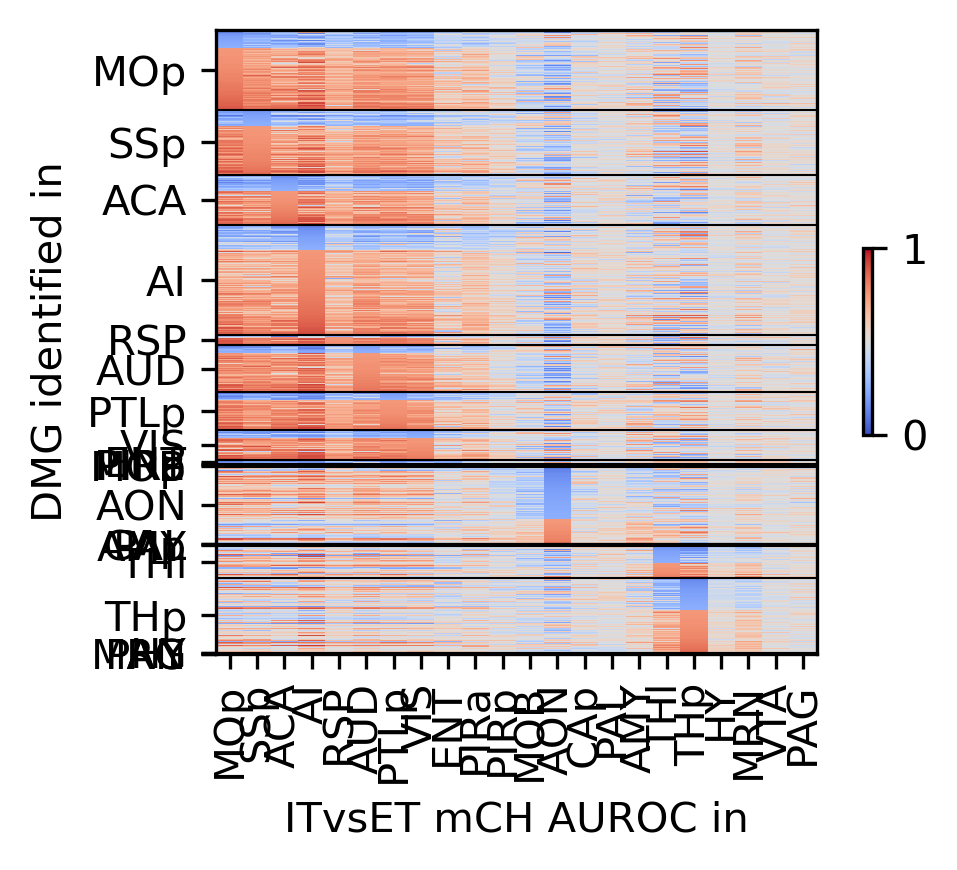

In [81]:
fig, ax = plt.subplots(figsize=(4,3), dpi=300)
plot = ax.imshow(data, vmin=0, vmax=1, aspect='auto', cmap='coolwarm', interpolation='none', rasterized=True)
ax.set_xticks(np.arange(len(source_list)))
ax.set_xticklabels(source_list, rotation=90)
ax.set_yticks([])
ax.set_ylabel('DMG identified in')
ax.set_xlabel('ITvsET mCH AUROC in')
yticks = []
for i in range(len(source_list)):
    # ax.plot([i-0.5,i-0.5], [offset[i], offset[i+1]], 'w')
    # ax.plot([i+0.5,i+0.5], [offset[i], offset[i+1]], 'w')
    # ax.plot([i-0.5,i+0.5], [offset[i], offset[i]], 'w')
    # ax.plot([i-0.5,i+0.5], [offset[i+1], offset[i+1]], 'w')
    ax.plot([-0.5, data.shape[1]-0.5], [offset[i+1], offset[i+1]], 'k', linewidth=0.5)
    yticks.append((offset[i+1]+offset[i]) // 2)

ax.set_xlim([-0.5, data.shape[1]-0.5])
ax.set_ylim([data.shape[0]-0.5, -0.5])
ax.set_yticks(yticks)
ax.set_yticklabels(source_list)

cbar = plt.colorbar(plot, ax=ax, shrink=0.3, fraction=0.3)
cbar.set_ticks([cbar.vmin, cbar.vmax])
# cbar.set_label('AUROC (IT vs ET)')
plt.tight_layout()
plt.savefig('plot/DMG_ROC_crosssource.pdf', transparent=True)


In [100]:
selg = pd.Series(False, index=result.index)
for reg in source_list:
    selg = selg | ((result_roc[reg] - 0.5).abs()>0.25)

data = result_roc.loc[selg]
data.shape

(2540, 22)

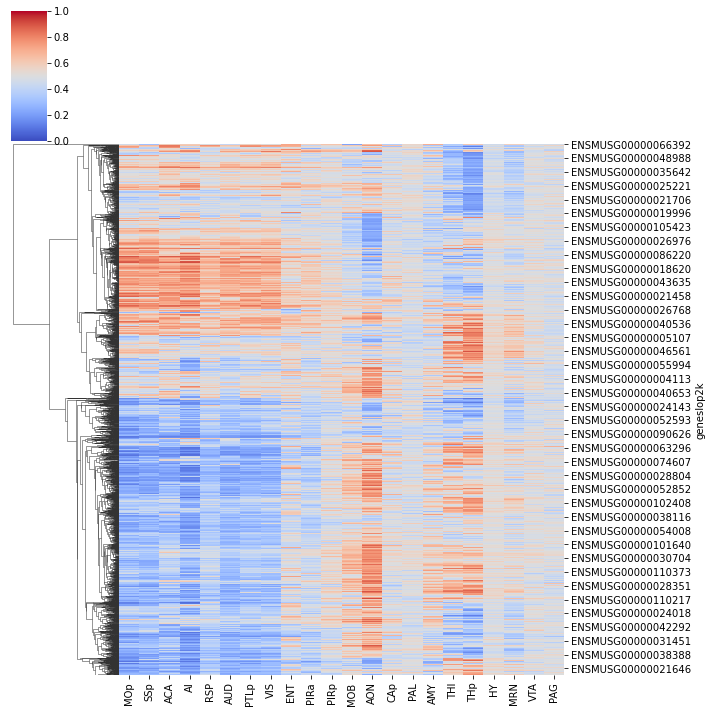

In [101]:
cg = sns.clustermap(data, vmin=0, vmax=1, col_cluster=False, cmap='coolwarm', metric='cosine')


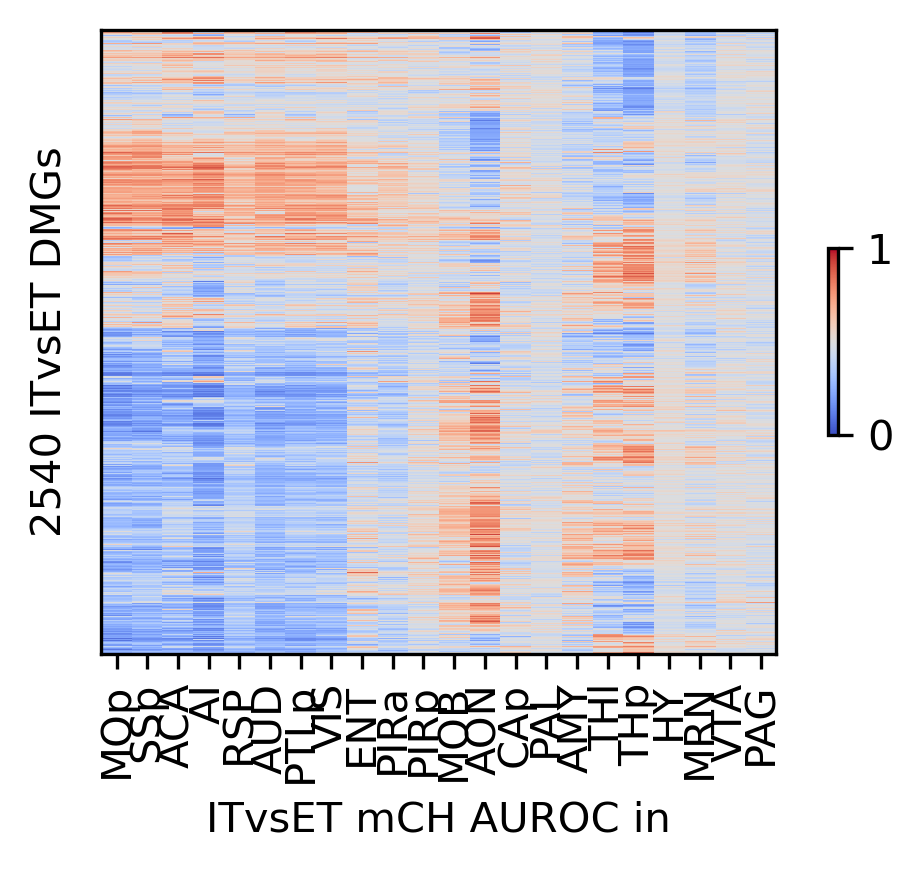

In [103]:
fig, ax = plt.subplots(figsize=(4,3), dpi=300)
plot = ax.imshow(data.iloc[cg.dendrogram_row.reordered_ind], vmin=0, vmax=1, aspect='auto', cmap='coolwarm', interpolation='none', rasterized=True)
ax.set_xticks(np.arange(len(source_list)))
ax.set_xticklabels(source_list, rotation=90)
ax.set_ylabel(f'{selg.sum()} ITvsET DMGs')
ax.set_xlabel('ITvsET mCH AUROC in')

ax.set_xlim([-0.5, data.shape[1]-0.5])
ax.set_ylim([data.shape[0]-0.5, -0.5])
ax.set_yticks([])
# ax.set_yticklabels(source_list)

cbar = plt.colorbar(plot, ax=ax, shrink=0.3, fraction=0.3)
cbar.set_ticks([cbar.vmin, cbar.vmax])
plt.tight_layout()
# cbar.set_label('log2 Fold Change (log2 IT/ET)')
plt.savefig('plot/DMG_ROC_allsource.pdf', transparent=True)


In [108]:
result_tmp

,biorep,comprep
MOp,0.935705,0.949113
SSp,0.952076,0.955355
ACA,0.924577,0.927922
AI,0.963389,0.963450
RSP,0.848352,0.859122
AUD,0.927589,0.936028
PTLp,0.924359,0.917430
VIS,0.907459,0.912818
ENT,0.776389,0.915519
PIRa,NaN,0.833402


In [6]:
result_group = pd.read_hdf('/home/jzhou_salk_edu/sky_workdir/230207_targetsubgroup_roc/result.hdf', key='data')
result_group

,biorep,comprep,ave,1-L4OS,Source,Target1,Target2,SourceGroup
MOp-CTX/CNU,0.765720,0.806431,0.871339,0.356206,MOp,CTX,CNU,CTX
MOp-CTX/IB,0.976677,0.980823,0.983430,0.841739,MOp,CTX,IB,CTX
MOp-CTX/MB,0.952966,0.957444,0.977116,0.894556,MOp,CTX,MB,CTX
MOp-CTX/HB,0.970702,0.975783,0.986352,0.905724,MOp,CTX,HB,CTX
MOp-CNU/IB,0.900749,0.934809,0.934365,0.808250,MOp,CNU,IB,CTX
...,...,...,...,...,...,...,...,...
PAG-IB/HB,NaN,0.742728,0.739927,0.580256,PAG,IB,HB,MB
IC-CTX/IB,NaN,0.989991,0.989991,0.982143,IC,CTX,IB,MB
P-IB/MB,NaN,0.936536,0.937615,0.585746,P,IB,MB,HB
P-MB/HB,NaN,0.908819,0.908785,0.722571,P,MB,HB,HB


In [13]:
result = result_tmp[['comprep']].rename({'comprep':'IT/ET'}, axis=1)
result

,IT/ET
MOp,0.949113
SSp,0.955355
ACA,0.927922
AI,0.963450
RSP,0.859122
AUD,0.936028
PTLp,0.917430
VIS,0.912818
ENT,0.915519
PIRa,0.833402


In [14]:
for xx in ['CTX', 'MOB', 'CNU']:
    for yy in ['IB', 'MB', 'HB']:
        tmp = result_group.loc[(result_group['Target1']==xx) & (result_group['Target2']==yy)]
        tmp.index = tmp['Source']
        tmp = tmp[['comprep']].rename({'comprep':f'{xx}/{yy}'}, axis=1)
        result = pd.concat([result, tmp], axis=1)
    

In [15]:
result = result.loc[result.index!='IC']
result['color'] = result.index.map(colors)

In [16]:
result.index.name = 'Source'

,Source,variable,value
0,MOp,IT/ET,0.949113
1,SSp,IT/ET,0.955355
2,ACA,IT/ET,0.927922
3,AI,IT/ET,0.963450
4,RSP,IT/ET,0.859122
...,...,...,...
215,THp,CNU/HB,NaN
216,HY,CNU/HB,0.805357
217,MRN,CNU/HB,0.854428
218,VTA,CNU/HB,0.824618


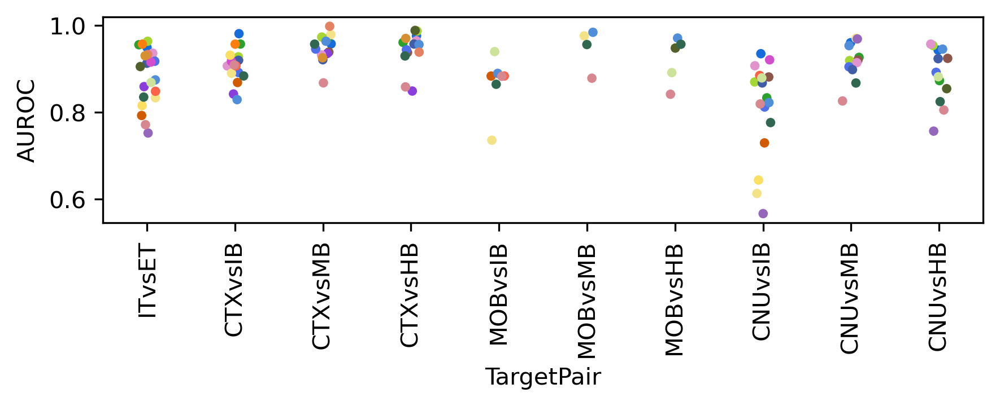

In [22]:
tmp = pd.melt(result.reset_index(), id_vars='Source', value_vars=result.columns[:-1], var_name='TargetPair', value_name='AUROC')
tmp = tmp[~tmp['AUROC'].isna()]

fig, ax = plt.subplots(figsize=(6,2.5), dpi=300)
sns.stripplot(data=tmp, x='TargetPair', y='AUROC', hue='Source', palette=result['color'].to_dict(), order=result.columns[:-1], s=4, ax=ax)
ax.set_xticklabels(['vs'.join(xx.split('/')) for xx in result.columns[:-1]], rotation=90, fontsize=10)
ax.legend([],[], frameon=False)
plt.tight_layout()
plt.savefig('plot/ITETvsSubGroup_roc_strip.pdf', transparent=True)


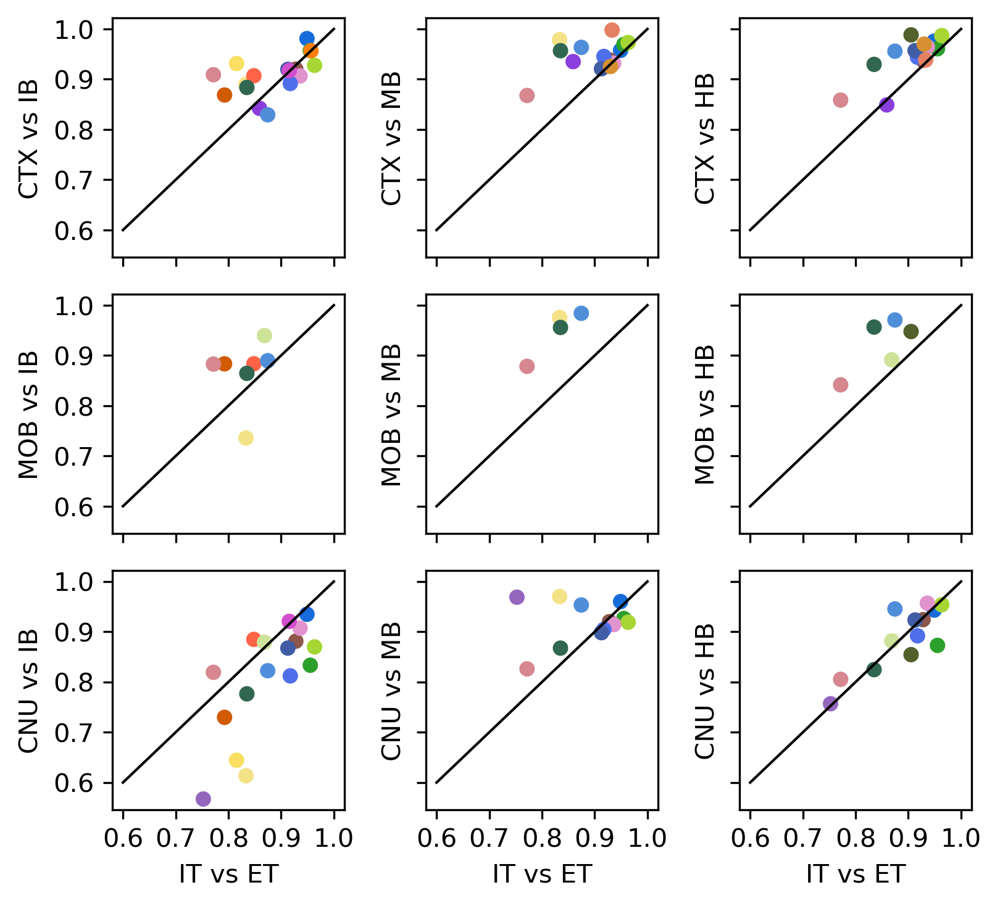

In [56]:
ticks = [0.6, 0.7, 0.8, 0.9, 1.0]
fig, axes = plt.subplots(3, 3, figsize=(5.5,5), sharex='all', sharey='all', dpi=300)
for i,xx in enumerate(['CTX', 'MOB', 'CNU']):
    for j,yy in enumerate(['IB', 'MB', 'HB']):
        ax = axes[i,j]
        tmp = result[['IT/ET', f'{xx}/{yy}', 'color']]
        tmp = tmp.loc[tmp.isna().sum(axis=1)==0]
        ax.scatter(tmp['IT/ET'], tmp[f'{xx}/{yy}'], c=tmp['color'], edgecolor='none')
        ax.plot([0.6, 1.0], [0.6, 1.0], color='k', linewidth=1)
        ax.set_xticks(ticks)
        ax.set_xticklabels(ticks, fontsize=10)
        ax.set_yticks(ticks)
        ax.set_yticklabels(ticks, fontsize=10)
        ax.set_ylabel(f'{xx} vs {yy}', fontsize=10)
for ax in axes[-1]:
    ax.set_xlabel(f'IT vs ET', fontsize=10)

plt.tight_layout()
plt.savefig('plot/ITETvsSubGroup_roc_scatter.pdf', transparent=True)


In [ ]:
fig, axes = plt.subplots(2, 5, figsize=(20, 8), dpi=300, constrained_layout=True)
for i,xx in enumerate(reg_group):
    data = anndata.read_h5ad(glob(f'/home/jzhou_salk_edu/sky_workdir/221122-cemba-tenx-integration/{xx}/{xx}_*_rs1rs2rna.h5ad')[0])
    ax = axes.flatten()[i]
    ax.scatter(
        data.obs[f"{coord_base}_0"],
        data.obs[f"{coord_base}_1"],
        c="#e0e0e0",
        edgecolors="none",
        s=10000/data.shape[0],
        alpha=0.5,
        rasterized=True,
    )
    tmp = data.obs.loc[data.obs['Study']=='CEMBA_EpiRetro']
    tmp[['TargetGroup', 'SubRegion']] = adata_neu.obs.loc[tmp.index, ['TargetGroup', 'SubRegion']].values
    tmp = tmp.loc[(tmp['SubRegion'].isin(reg_group[xx])) & (tmp['TargetGroup'].isin(['IT', 'ET']))]
    _ = categorical_scatter(
        data=tmp,
        ax=ax,
        coord_base=coord_base,
        s=min(5, 10000/tmp.shape[0]),
        hue="TargetGroup",
        palette={'ET':'C0', 'IT':'C1'},
        labelsize=10,
        max_points=None,
        scatter_kws={"rasterized": True},
        show_legend=False,
        outline=None,
        # legend_kws = {'ncol':1, 'fontsize':10}
    )
    ax.set_title(xx, fontsize=15)

# for ax in axes.flatten()[len(reg_list):]:
#     ax.axis('off')


In [66]:
tarsubtype = {
    "CTX": [
        "PFC",
        "MOp",
        "SSp",
        "ACA",
        "AI",
        "AUDp",
        "RSP",
        "PTLp",
        "VISp",
        "ENT",
        "HPF",
        "PIR",
    ],
    "MOB": ["MOB"],
    "AMY": ["AMY"],
    "CNU": ["STR", "PAL"],
    "IB": ["TH", "HY"],
    "MB": ["SC", "VTA"],
    "HB": ["P", "MY"],
    "CB": ["CBN", "CBX"],
}
tarsubmap = {yy: xx for xx in tarsubtype for yy in tarsubtype[xx]}
tarall = list(tarsubtype.keys())
palette = {'CNU':'C1', 'IB':'C2', 'CTX':'C0', 'HB':'C4'}


In [73]:
xx = 'MB'
data = anndata.read_h5ad(glob(f'/home/jzhou_salk_edu/sky_workdir/221122-cemba-tenx-integration/{xx}/{xx}_*_rs1rs2rna.h5ad')[0])

In [74]:
data.obs['Target'] = data.obs['Target'].astype(str)
data.obs.loc[~data.obs.index.isin(meta_rs2.index), 'Target'] = '?'


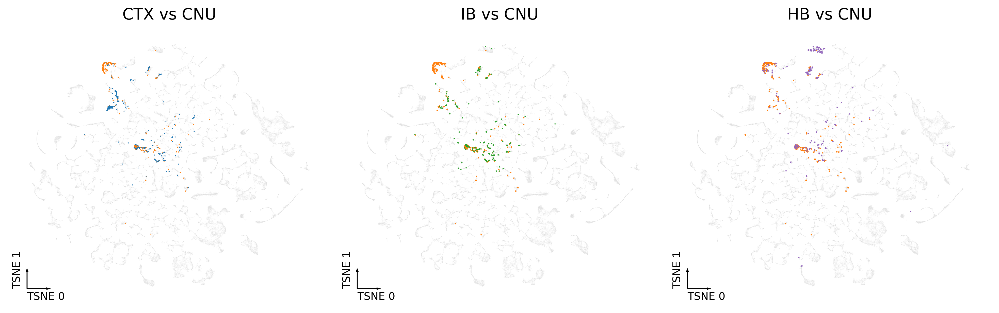

In [75]:
t = 'VTA'
fig, axes = plt.subplots(1, 3, figsize=(13, 4), dpi=300, constrained_layout=True)
for i,yy in enumerate(['CTX', 'IB', 'HB']):
    ax = axes[i]
    ax.scatter(
        data.obs[f"{coord_base}_0"],
        data.obs[f"{coord_base}_1"],
        c="#e0e0e0",
        edgecolors="none",
        s=10000/data.shape[0],
        alpha=0.5,
        rasterized=True,
    )
    tmp = data.obs.loc[data.obs['Slice'].isin(rs2_subregion_dict[t]) & (data.obs['Target']!='?')]
    tmp['TargetGroup'] = tmp['Target'].map(tarsubmap)
    tmp = tmp.loc[tmp['TargetGroup'].isin(['CNU', yy])]
    # tmp[['TargetGroup', 'SubRegion']] = adata_neu.obs.loc[tmp.index, ['TargetGroup', 'SubRegion']].values
    # tmp = tmp.loc[(tmp['SubRegion'].isin(reg_group[xx])) & (tmp['TargetGroup'].isin(['IT', 'ET']))]
    _ = categorical_scatter(
        data=tmp,
        ax=ax,
        coord_base=coord_base,
        s=min(5, 1000/tmp.shape[0]),
        hue="TargetGroup",
        palette=palette,
        labelsize=10,
        max_points=None,
        scatter_kws={"rasterized": True},
        # show_legend=True,
        outline=None,
        # legend_kws = {'ncol':1, 'fontsize':10}
    )
    ax.set_title(f'{yy} vs CNU', fontsize=15)



In [76]:
xx = 'CTX'
data = anndata.read_h5ad(glob(f'/home/jzhou_salk_edu/sky_workdir/221122-cemba-tenx-integration/{xx}/{xx}_*_rs1rs2rna.h5ad')[0])

In [77]:
data.obs['Target'] = data.obs['Target'].astype(str)
data.obs.loc[~data.obs.index.isin(meta_rs2.index), 'Target'] = '?'


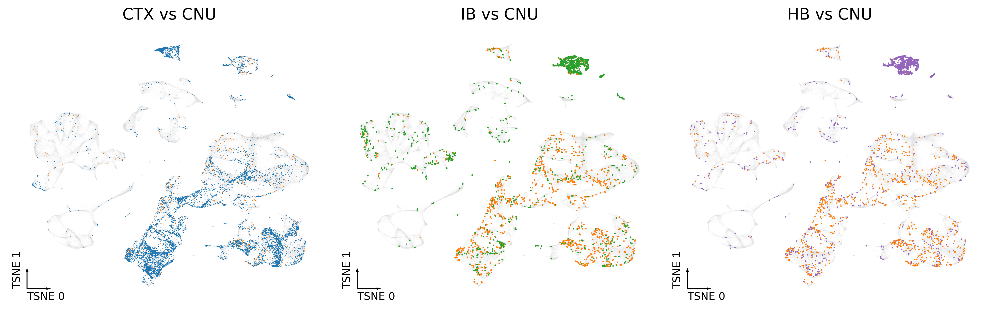

In [78]:
palette = {'CNU':'C1', 'IB':'C2', 'CTX':'C0', 'HB':'C4'}
fig, axes = plt.subplots(1, 3, figsize=(13, 4), dpi=300, constrained_layout=True)
for i,yy in enumerate(['CTX', 'IB', 'HB']):
    ax = axes[i]
    ax.scatter(
        data.obs[f"{coord_base}_0"],
        data.obs[f"{coord_base}_1"],
        c="#e0e0e0",
        edgecolors="none",
        s=10000/data.shape[0],
        alpha=0.5,
        rasterized=True,
    )
    tmp = data.obs.loc[data.obs['Target']!='?']
    tmp['TargetGroup'] = tmp['Target'].map(tarsubmap)
    tmp = tmp.loc[tmp['TargetGroup'].isin(['CNU', yy])]
    # tmp[['TargetGroup', 'SubRegion']] = adata_neu.obs.loc[tmp.index, ['TargetGroup', 'SubRegion']].values
    # tmp = tmp.loc[(tmp['SubRegion'].isin(reg_group[xx])) & (tmp['TargetGroup'].isin(['IT', 'ET']))]
    _ = categorical_scatter(
        data=tmp,
        ax=ax,
        coord_base=coord_base,
        s=min(5, 5000/tmp.shape[0]),
        hue="TargetGroup",
        palette=palette,
        labelsize=10,
        max_points=None,
        scatter_kws={"rasterized": True},
        # show_legend=True,
        outline=None,
        # legend_kws = {'ncol':1, 'fontsize':10}
    )
    ax.set_title(f'{yy} vs CNU', fontsize=15)



In [68]:
import xarray as xr

dev = xr.open_zarr('/cemba/LinnarssonMouseBrainDev/MouseBrainDev.SubclassByAge.zarr')
dev

<xarray.Dataset>
Dimensions:     (subclass: 132, gene: 31053, age: 20)
Coordinates:
  * age         (age) object 'e7.0' 'e8.0' 'e8.5' ... 'e17.0' 'e17.5' 'e18.0'
  * gene        (gene) object 'ENSMUSG00000038751' ... 'ENSMUSG00000063808'
  * subclass    (subclass) <U37 'Parietal endoderm' ... 'Pituitary neuroendoc...
Data variables:
    CPM         (subclass, gene, age) float32 dask.array<chunksize=(17, 3882, 5), meta=np.ndarray>
    data        (subclass, gene, age) uint32 dask.array<chunksize=(20, 31053, 20), meta=np.ndarray>
    sample_sum  (subclass, age) uint64 dask.array<chunksize=(132, 20), meta=np.ndarray>

In [69]:
dev.get_index('subclass')

Index(['Parietal endoderm', 'Extraembryonic ectoderm', 'Endoderm',
       'Visceral endoderm', 'Extraembryonic endoderm', 'Cardiac mesoderm',
       'Osteochondral mesoderm', 'Mesoderm', 'Hematoendothelial lineage',
       'Mesenchyme',
       ...
       'Midbrain dopaminergic', 'Mixed region and neurotransmitter',
       'Mixed region GABAergic', 'Cerebellum GABAergic',
       'Posterior hindbrain glutamatergic', 'Dorsal midbrain glutamatergic',
       'Cerebellum glutamatergic', 'Epithalamus glutamatergic',
       'Diencephalon glutamatergic', 'Pituitary neuroendocrine'],
      dtype='object', name='subclass', length=132)

In [26]:
tarsubtype = {
    "CTX": ["PFC", "MOp", "SSp", "ACA", "AI", "AUDp", "RSP", "PTLp", "VISp", "ENT", "HPF", "PIR"],
    "MOB": ["MOB"],
    "CNU": ["AMY", "STR", "PAL"],
    "IB": ["TH", "HY"],
    "MB": ["SC", "VTA"],
    "HB": ["P", "MY"],
    "CB": ["CBN", "CBX"],
}
tarsubmap = {yy: xx for xx in tarsubtype for yy in tarsubtype[xx]}

In [38]:
meta = cemba.get_mc_mapping_metric()
meta

,mCCCFrac,mCGFrac,mCHFrac,FinalmCReads,DissectionRegion,Plate,Col384,Row384,Slice,Sample,Technology,InputReads,PassBasicQC,PlateNormCov,CEMBARegion,MajorRegion,SubRegion
cell,,,,,,,,,,,,,,,,,
10A_M_1,0.008874,0.819390,0.036336,1073981.0,RSP-4,CEMBA190423_10A_1,0,1,10,10A_190423,snmC-seq2,2252674,True,0.834409,10A,Isocortex,RSP
10A_M_100,0.007105,0.762382,0.019705,1108484.0,RSP-4,CEMBA190423_10A_2,0,3,10,10A_190423,snmC-seq2,2549478,True,0.842048,10A,Isocortex,RSP
10A_M_1000,0.006450,0.744689,0.016373,1443814.0,RSP-4,CEMBA190423_10A_4,7,5,10,10A_190423,snmC-seq2,3342484,True,1.031215,10A,Isocortex,RSP
10A_M_1001,0.007433,0.780743,0.029361,1372174.0,RSP-4,CEMBA190423_10A_3,8,4,10,10A_190423,snmC-seq2,3220214,True,0.942444,10A,Isocortex,RSP
10A_M_1002,0.006215,0.741165,0.018129,1650777.0,RSP-4,CEMBA190423_10A_3,8,5,10,10A_190423,snmC-seq2,3871980,True,1.133796,10A,Isocortex,RSP
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
17A_M_3051,0.007412,0.747842,0.018610,1559491.0,CB-4,CEMBA210812_17A_4,1,14,17,17A_210812,snmC-seq3,4589584,True,1.090938,17A,CB,CBX
17A_M_3052,0.008806,0.830814,0.043916,1219087.0,CB-4,CEMBA210812_17A_4,0,15,17,17A_210812,snmC-seq3,3510150,True,0.852810,17A,CB,CBX
17A_M_3053,0.006352,0.768759,0.023178,1723321.0,CB-4,CEMBA210812_17A_4,12,15,17,17A_210812,snmC-seq3,4903466,True,1.205545,17A,CB,CBX


In [39]:
meta = meta[["MajorRegion", "SubRegion", "CEMBARegion", "DissectionRegion"]]

In [41]:
meta[["MajorRegion", "DissectionRegion"]].drop_duplicates().set_index(
    "DissectionRegion"
).sort_values("MajorRegion").loc[
    [
        "PIR-1",
        "PIR-2",
        "PIR-3",
        "PIR-4",
        "PIR-5",
        "PIR-6",
        "PIR-7",
        "PIR-8",
        "MOB",
        "AON",
    ]
]

,MajorRegion
DissectionRegion,
PIR-1,OLF
PIR-2,OLF
PIR-3,OLF
PIR-4,OLF
PIR-5,OLF
PIR-6,OLF
PIR-7,OLF
PIR-8,OLF
MOB,OLF


In [ ]:
meta[["MajorRegion", "CEMBARegion"]].drop_duplicates().set_index(
    "CEMBARegion"
).sort_values("MajorRegion").loc[["7H", "8H", "9G"]]